In [1]:
import os
import sys
import glob
import pandas as pd
import numpy as np
import pickle
import nibabel as nib 

import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
from matplotlib.colors import TwoSlopeNorm
import scipy.ndimage as ndimage

import torch

import significantdigits as sig

/usr/local/lib/python3.9/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [15]:
def analyze_embeddings(block_layers, embed_dir, colormap, dict_type=True, v2=False, std_vmin=None, std_vmax=None, mean_vmin=None, mean_vmax=None):
    layers = {}

    for embed in block_layers:
        print(embed)
        layers[embed] = []
        if v2: 
            embedv2 = f"{embed}_?.pkl"
        else:
            embedv2 = f"{embed}*"
        for file in glob.glob(f'{embed_dir}/{embed}/*{embedv2}'):
            if dict_type: 
                if embed == 'unpool':
                    layers[embed].append(pickle.load(open(file, 'rb'))[embed].squeeze())
                else:
                    layers[embed].append(pickle.load(open(file, 'rb'))[embed].numpy().squeeze())
            else:
                if embed == 'unpool':
                    layers[embed].append(pickle.load(open(file, 'rb')).squeeze())
                else:
                    if 'y' in embed:
                        layers[embed].append(pickle.load(open(file, 'rb')).numpy().squeeze())
                    else:
                        layers[embed].append(pickle.load(open(file, 'rb'))[0].numpy().squeeze())

        layers[embed] = np.array(layers[embed], dtype=np.float64)

        print(layers[embed].shape)

    for embed in block_layers:
        fig, axes = plt.subplots(1, 3, figsize=(20,5))
        print(embed)

        layer_sig = sig.significant_digits(layers[embed], reference=np.mean(layers[embed], axis=0, dtype=np.float64), method=sig.Method.CNH, basis=10, dtype=np.float64)
        # print(layer_sig.shape)
        gc = sns.heatmap(np.mean(layer_sig, axis=0, dtype=np.float64), ax=axes[0], vmin=0, vmax=7, cmap='RdYlGn', cbar=True)
        # gc.axes.get_yaxis().set_visible(False), gc.axes.get_xaxis().set_visible(False)
        gc.set_title(f"Significant Digits\nMax: {np.max(layer_sig):.2f} and Min: {np.min(layer_sig):.2f}")

        layer_std = np.std(layers[embed], axis=0,dtype=np.float64)
        layer_std = np.mean(layer_std, axis=0,dtype=np.float64)
        # layer_std = np.where(layer_std ==0, 0, np.log10(layer_std))
        if std_vmax:
            gc = sns.heatmap(layer_std, ax=axes[1], vmin=std_vmin, vmax=std_vmax, cmap=colormap, norm=LogNorm(vmin=std_vmin, vmax=std_vmax), cbar=True)
        else:
            gc = sns.heatmap(layer_std, ax=axes[1], cmap=colormap, cbar=True)

        # gc.axes.get_yaxis().set_visible(False), gc.axes.get_xaxis().set_visible(False)
        gc.set_title(f"Standard deviation\nMax: {np.max(layer_std,):.2f} and Min: {np.min(layer_std):.2f}");

        layer_mean = np.mean(layers[embed], axis=0,dtype=np.float64)
        norm = TwoSlopeNorm(vmin=layer_mean.min()/2, vcenter=0, vmax=layer_mean.max()/2)

        if mean_vmin:
            norm = TwoSlopeNorm(vmin=mean_vmin, vcenter=0, vmax=mean_vmax)
            gc = sns.heatmap(np.mean(layer_mean, axis=0,dtype=np.float64), ax=axes[2], vmin=mean_vmin, vmax=mean_vmax, norm=norm, cmap='twilight', cbar=True)
        else:
            gc = sns.heatmap(np.mean(layer_mean, axis=0,dtype=np.float64), ax=axes[2], norm=norm, cmap='twilight', cbar=True)

        
        # gc.axes.get_yaxis().set_visible(False), gc.axes.get_xaxis().set_visible(False)
        gc.set_title(f"Mean\nMax: {np.max(layer_mean):.2f} and Min: {np.min(layer_mean):.2f}");
        plt.suptitle(f"{embed}\n", y=1.02, fontsize=15);
        # break

0_0_base
(10, 64, 192, 224)
0_0_bilinear
(10, 64, 224, 256)
1_0_pool
(10, 64, 112, 128)
2_0_pool
(10, 64, 56, 64)
3_0_pool
(10, 64, 28, 32)
4_0_pool
(10, 64, 14, 16)
5_0_pool
(10, 64, 7, 8)
6_0_unpool
(10, 64, 14, 16)
5_1_unpool
(10, 64, 28, 32)
4_2_unpool
(10, 64, 56, 64)
3_3_unpool
(10, 64, 112, 128)
2_4_unpool
(10, 64, 224, 256)
2_2_unpool
(10, 64, 224, 256)
1_5_bilinear
(10, 64, 192, 224)
y1
(10, 2, 192, 224)
y6
(10, 2, 192, 224)
0_0_base
0_0_bilinear
1_0_pool
2_0_pool
3_0_pool
4_0_pool
5_0_pool
6_0_unpool


/usr/local/lib/python3.9/site-packages/significantdigits/_significantdigits.py:257: RuntimeWarning: invalid value encountered in divide
  return operator(x, y_reshaped)


5_1_unpool
4_2_unpool
3_3_unpool
2_4_unpool
2_2_unpool
1_5_bilinear
y1
y6


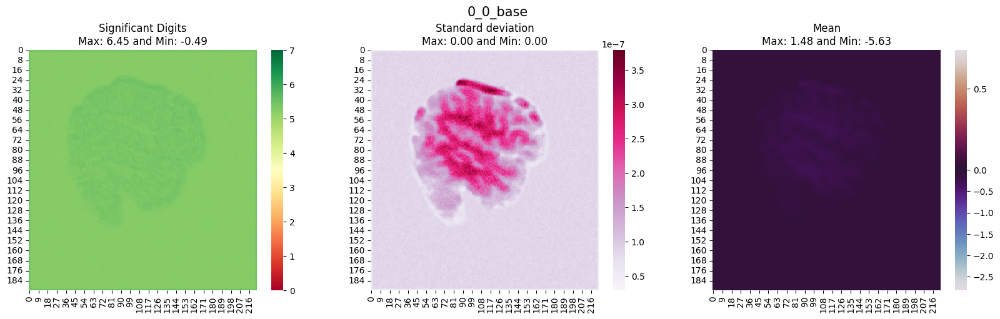

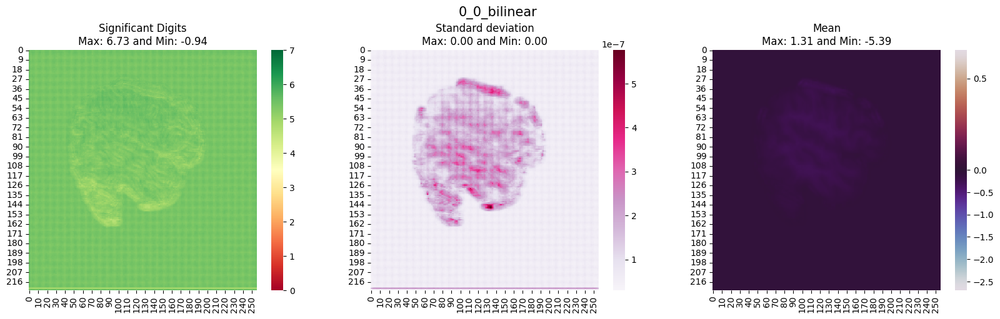

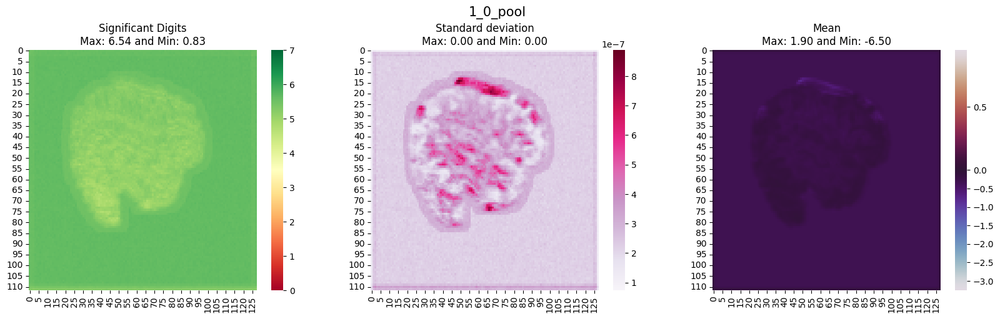

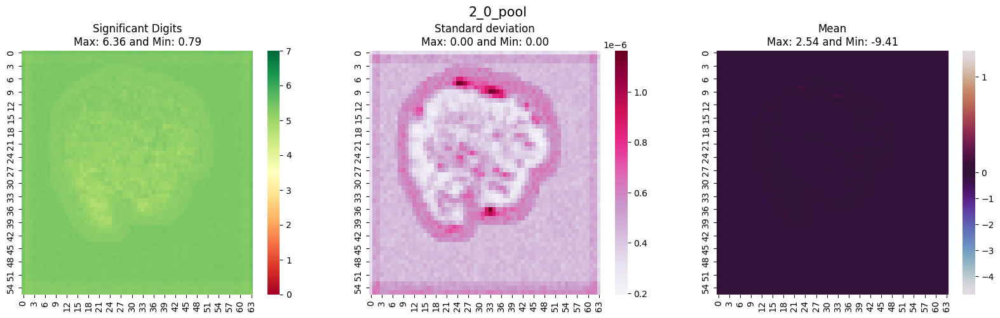

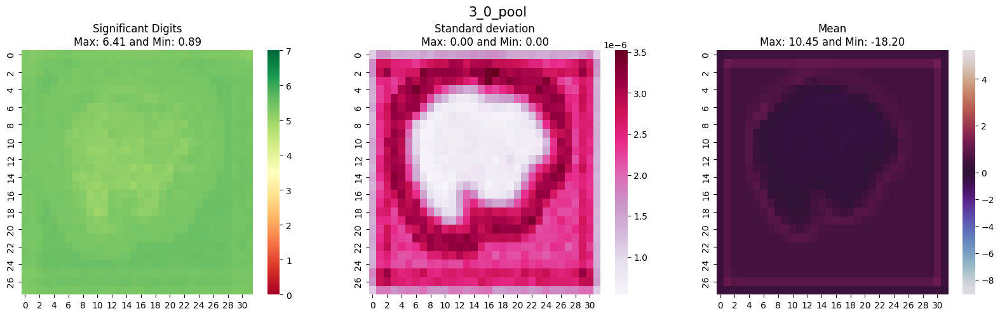

...

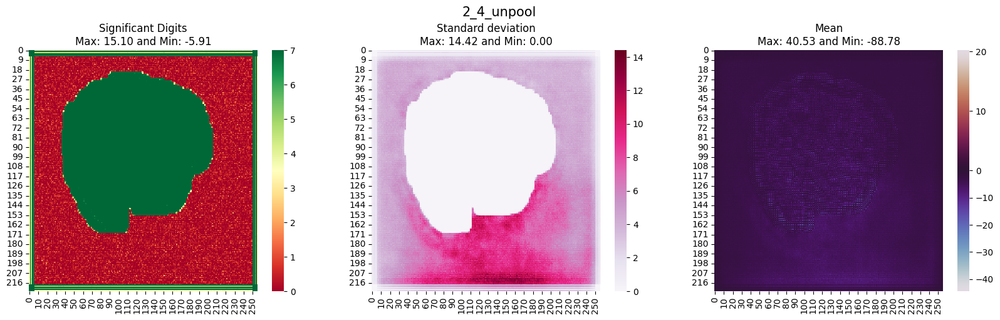

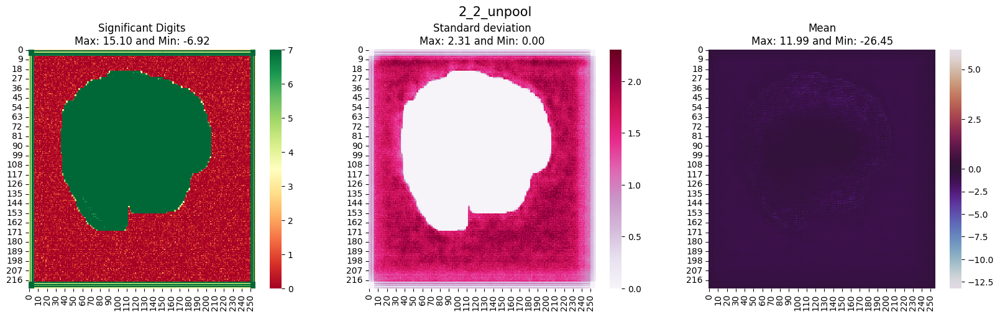

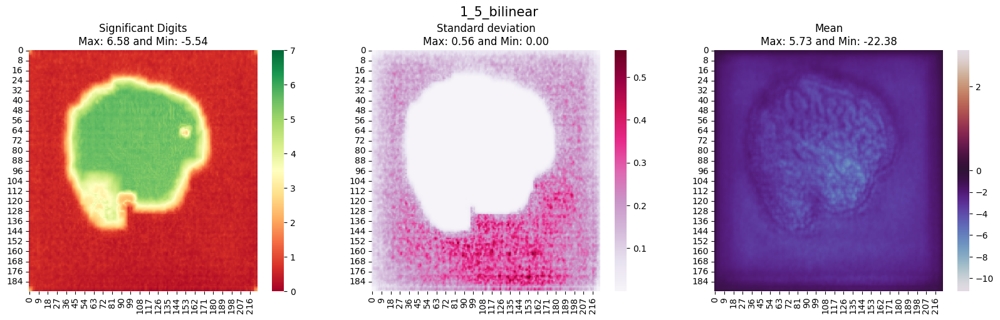

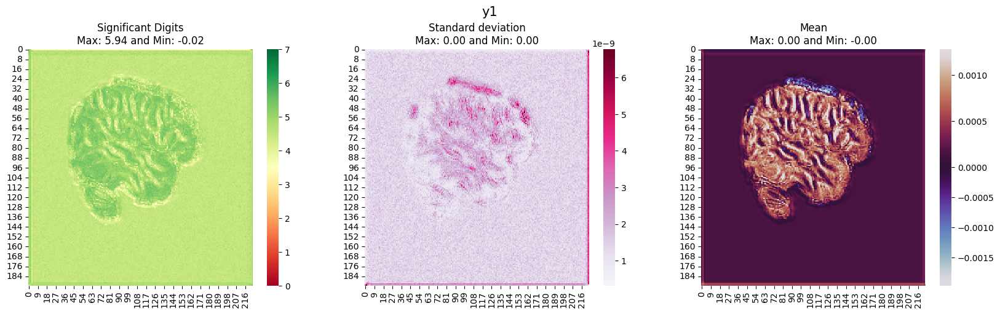

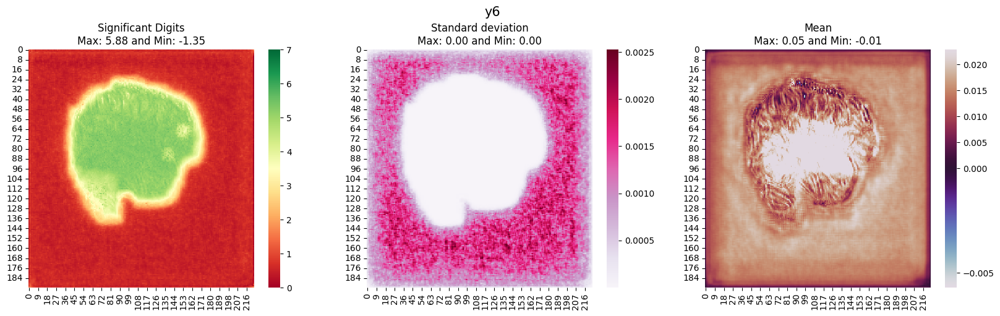

In [16]:
# analyze_embeddings(['1_5_bilinear', '2_2_unpool', '2_4_unpool', '3_3_unpool','4_2_unpool','5_1_unpool', '6_0_unpool', 'y1', 'y6','0_0_base_output', '0_0_bilinear', '1_0_pool_indices', '1_0_pool', '2_0_pool_indices', '2_0_pool', '3_0_pool_indices', '3_0_pool', '4_0_pool_indices', '4_0_pool', '5_0_pool_indices', '5_0_pool'],
                  #  './embeddings/embeddings_run_3', colormap='PuRd', dict_type=False)
analyze_embeddings(['0_0_base', '0_0_bilinear', '1_0_pool', '2_0_pool', '3_0_pool', '4_0_pool', '5_0_pool', '6_0_unpool', '5_1_unpool', '4_2_unpool','3_3_unpool', '2_4_unpool', '2_2_unpool', '1_5_bilinear', 'y1', 'y6'],'/workspaces/FONDUE/embeddings/embeddings_run_3/', colormap='PuRd', dict_type=False)
# analyze_embeddings(['0_0_base', '0_0_bilinear', '1_0_pool', '1_5_bilinear', '2_0_pool', '2_2_unpool', '2_4_unpool', '3_0_pool', '3_3_unpool', '4_0_pool', '4_2_unpool', '5_0_pool', '5_1_unpool', '6_0_unpool', 'y1', 'y6'],
                   

In [17]:
def abs_diff(input_array):
    input_array = np.asarray(input_array)
    channels, input_height, input_width = input_array[0].shape
    uniq_output = np.ndarray((channels,input_height, input_width))
    
    # Perform max pooling
    for c in range(channels):
        for i in range(input_height):
            for j in range(input_width):
                uniq_output[c,i,j] = len(get_unique(input_array, (c,i,j)))
    return uniq_output

def get_unique(input_array: list, index: tuple): 
  iter = len(input_array)
  indexes = np.zeros([iter])
  for i in range(iter):
    indexes[i] = input_array[i][index]
  return np.unique(indexes)

In [18]:
indices= []
# make regex later
file_indices = (1,3,4,5,6,7,8,9,10,14) 
for layer in range(1,6):
  indices_i = []
  for j in file_indices:
    indices_i.append(pickle.load(open(f'/workspaces/FONDUE/embeddings/embeddings_run_3/{layer}_0_pool_indices/{layer}_0_pool_indices_{j}.pkl', 'rb'))[1].numpy().squeeze())
  indices.append(abs_diff(indices_i))

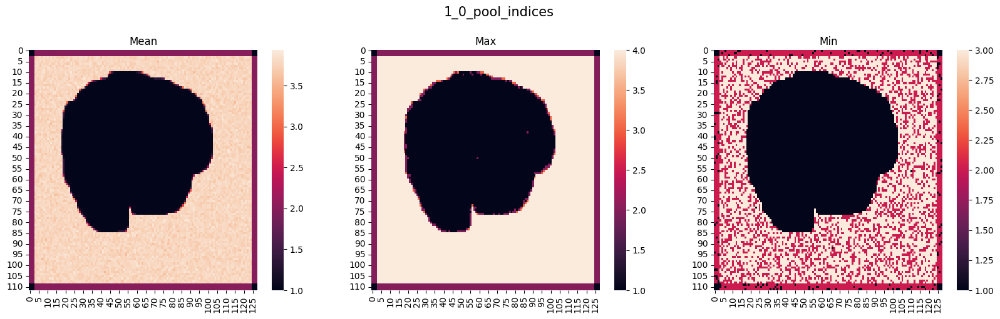

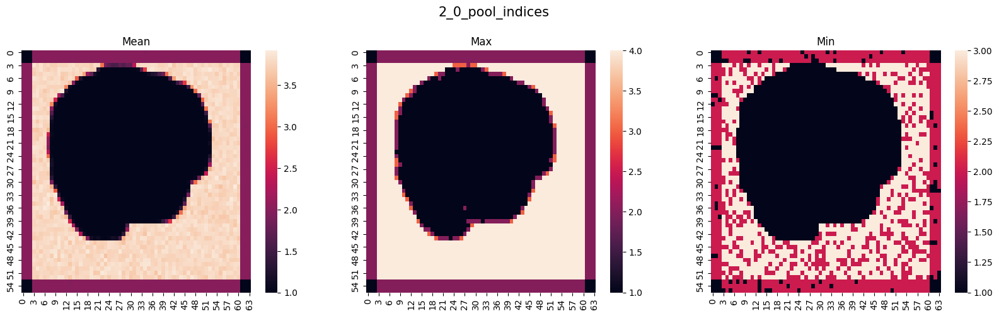

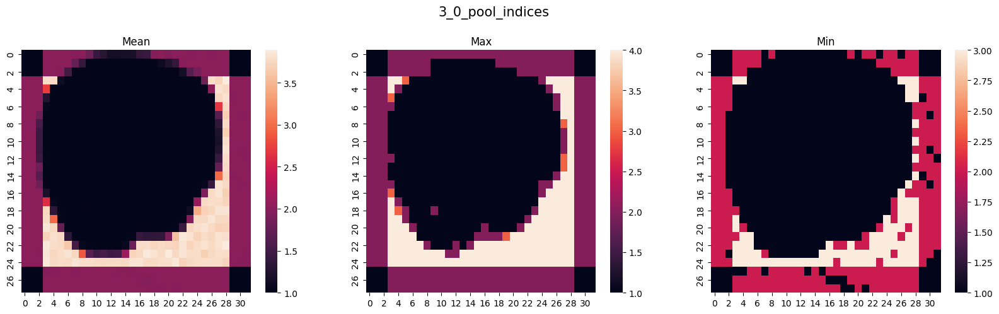

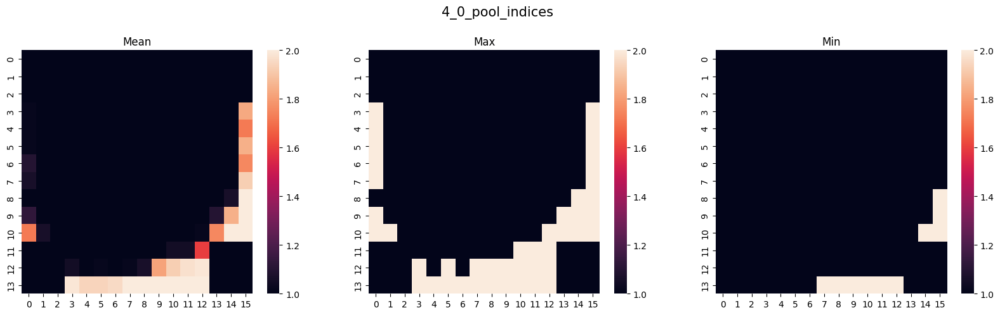

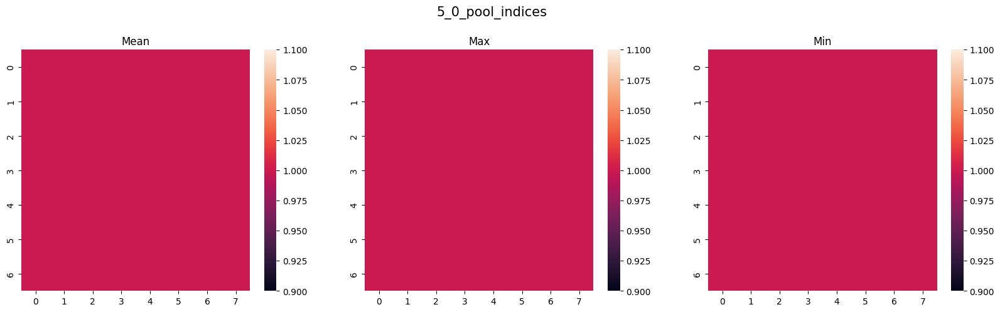

In [19]:
for index, indice in enumerate(indices):
  fig, axes = plt.subplots(1, 3, figsize=(20,5))
  gc = sns.heatmap(indice.mean(0), ax=axes[0])
  gc.set_title(f"Mean")
  gc = sns.heatmap(indice.max(0), ax=axes[1])
  gc.set_title(f"Max")
  gc = sns.heatmap(indice.min(0), ax=axes[2])
  gc.set_title(f"Min")
  plt.suptitle(f"{index+1}_0_pool_indices\n", y=1.02, fontsize=15);

# NaN Thresholds

In [8]:
layers = ['0_0_base_output', '0_0_bilinear', '1_0_pool', '2_0_pool', '3_0_pool', '4_0_pool', '5_0_pool', '6_0_unpool', '5_1_unpool', '4_2_unpool', '3_3_unpool', '2_4_unpool', '1_5_bilinear', '2_2_unpool', 'y1', 'y2', 'y3', 'y4', 'y5', 'y6']

fig_folder_root = "figs"
def analyse_nan(thresh, method='abs'):
    try:
        os.mkdir(os.path.join(fig_folder_root, thresh))
    except FileExistsError:
        print("Folder already exists")
        
    for layer in layers:
        if 'y' in layer:
            a=pickle.load(open(f'/workspaces/FONDUE/embeddings/nan_skip_{thresh}/{layer}.pkl', 'rb'))
            ieee=pickle.load(open(f'/workspaces/FONDUE/embeddings/ieee/{layer}.pkl', 'rb'))
        else:
            a=pickle.load(open(f'/workspaces/FONDUE/embeddings/nan_{thresh}/{layer}.pkl', 'rb'))[0]
            ieee=pickle.load(open(f'/workspaces/FONDUE/embeddings/ieee/{layer}.pkl', 'rb'))[0]
        if method == "abs":
            diff = torch.abs(a - ieee) 
        else:
            diff = torch.abs((a - ieee)/ieee)
            
        fig, axes = plt.subplots(1, 3, figsize=(20,5))
        gc = sns.heatmap(np.mean(a.detach().numpy().squeeze(), axis=0), ax=axes[0])
        gc.set_title(layer)
        gc = sns.heatmap(np.mean(ieee.detach().numpy().squeeze(), axis=0), ax=axes[1])
        gc.set_title(f'IEEE {layer}')
        if method == "abs":
            gc = sns.heatmap(np.mean(diff.detach().numpy().squeeze(), axis=0), cmap='RdYlGn_r', ax=axes[2])
        else:
            diff = diff.nan_to_num(nan=-1, posinf=2)
            cmap = matplotlib.colormaps['RdYlGn_r'].with_extremes(under='purple', over='lightsteelblue')
            gc = sns.heatmap(np.mean(diff.detach().numpy().squeeze(), axis=0),  cmap=cmap, vmin=0, vmax=1.0, ax=axes[2])
        if method == "abs":
            gc.set_title(f'Absolute Error')
        else:
            gc.set_title(f'Relative Error')
        plt.suptitle(f"{thresh.replace('_','.')} Threshold", y=1.02, fontsize=15);
        # plt.savefig(os.path.join(fig_folder_root, thresh, layer))
        
def analyse_nan_all(thresh):
    try:
        os.mkdir(os.path.join(fig_folder_root, thresh))
    except FileExistsError:
        print("Folder already exists")
        
    for layer in layers:
        if 'y' in layer:
            a=pickle.load(open(f'/workspaces/FONDUE/embeddings/nan_{thresh}/{layer}.pkl', 'rb'))
            ieee=pickle.load(open(f'/workspaces/FONDUE/embeddings/ieee_axial/{layer}.pkl', 'rb'))
        else:
            a=pickle.load(open(f'/workspaces/FONDUE/embeddings/nan_{thresh}/{layer}.pkl', 'rb'))[0]
            ieee=pickle.load(open(f'/workspaces/FONDUE/embeddings/ieee_axial/{layer}.pkl', 'rb'))[0]
        diff_abs = torch.abs(a - ieee) 
        diff_rel = torch.abs((a - ieee)/ieee)
            
        fig, axes = plt.subplots(1, 4, figsize=(25,5))
        gc = sns.heatmap(np.mean(a.detach().numpy().squeeze(), axis=0), ax=axes[0])
        gc.set_title(layer)

        gc = sns.heatmap(np.mean(ieee.detach().numpy().squeeze(), axis=0), ax=axes[1])
        gc.set_title(f'IEEE {layer}')

        gc = sns.heatmap(np.mean(diff_abs.detach().numpy().squeeze(), axis=0), cmap='RdYlGn_r', ax=axes[2])
        gc.set_title(f'Absolute Error')

        diff_rel = diff_rel.nan_to_num(nan=-1, posinf=2)
        cmap = matplotlib.colormaps['RdYlGn_r'].with_extremes(under='white', over='black')
        gc = sns.heatmap(np.mean(diff_rel.detach().numpy().squeeze(), axis=0),  cmap=cmap, vmin=0, vmax=1.0, ax=axes[3])
        gc.set_title(f'Relative Error')

        plt.suptitle(f"{thresh.replace('_','.')} Threshold", y=1.02, fontsize=15);
        # plt.savefig(os.path.join(fig_folder_root, thresh, layer))
        

## 1 Threshold
Time: 694s = ~11min

Folder already exists


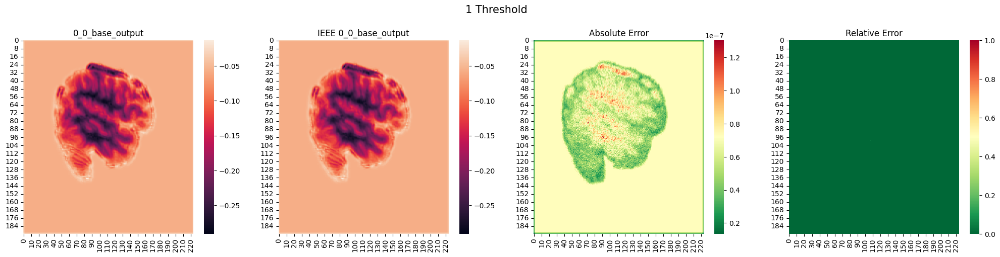

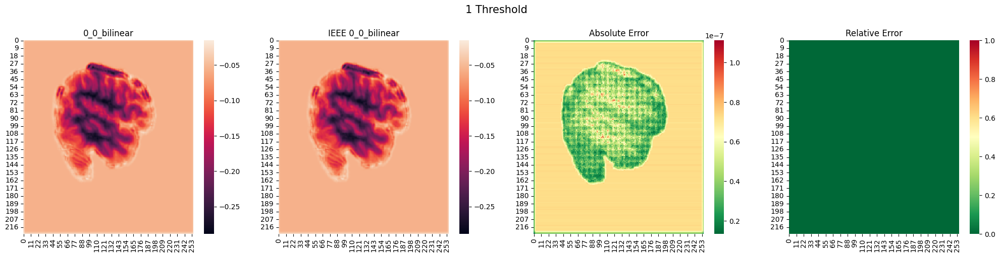

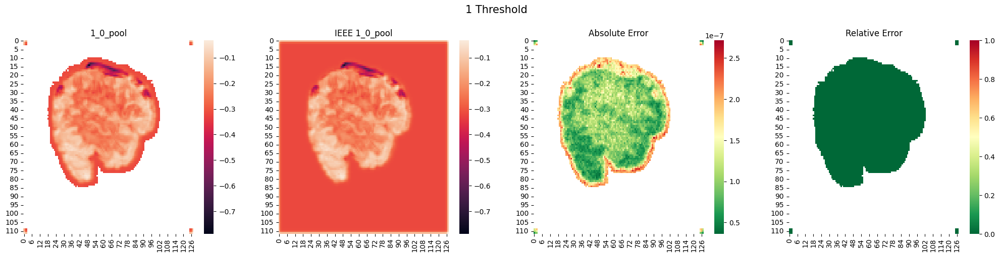

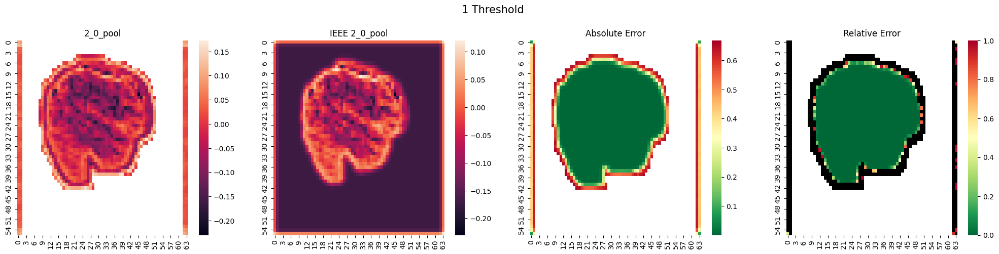

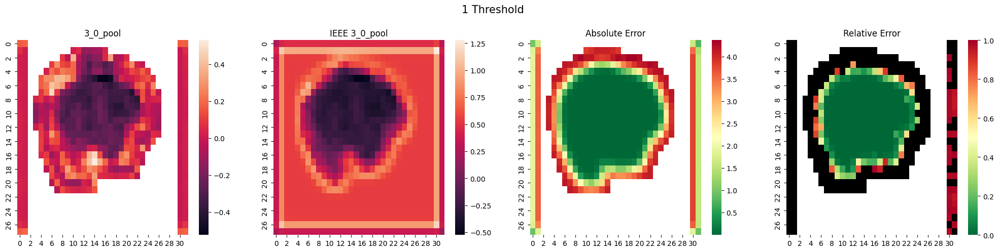

...

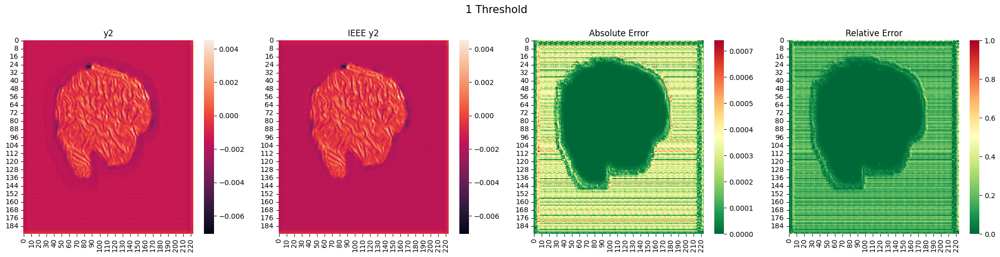

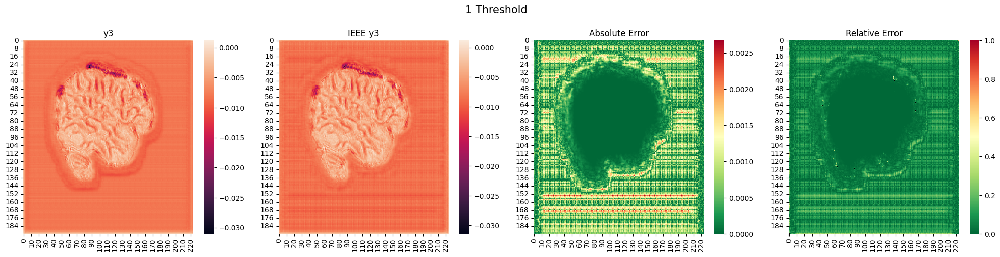

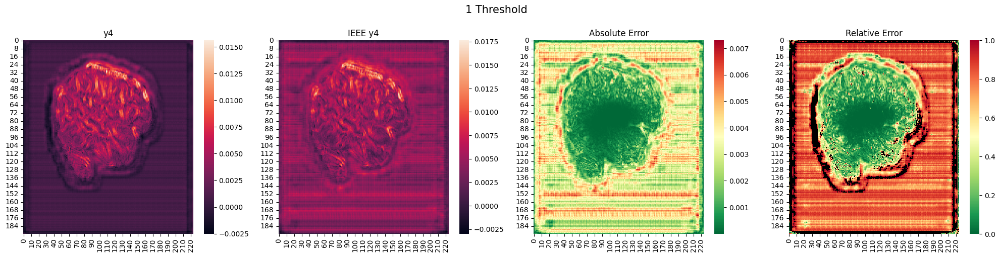

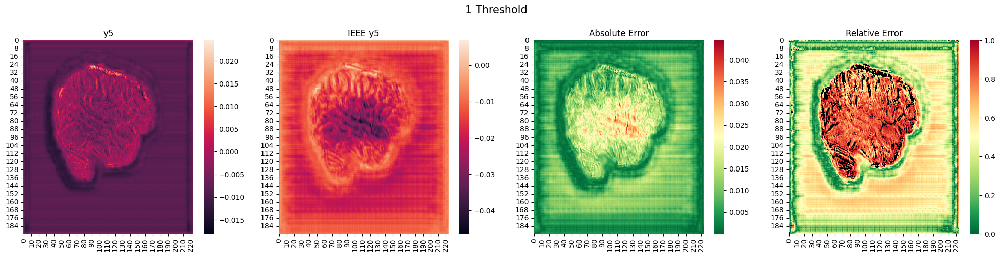

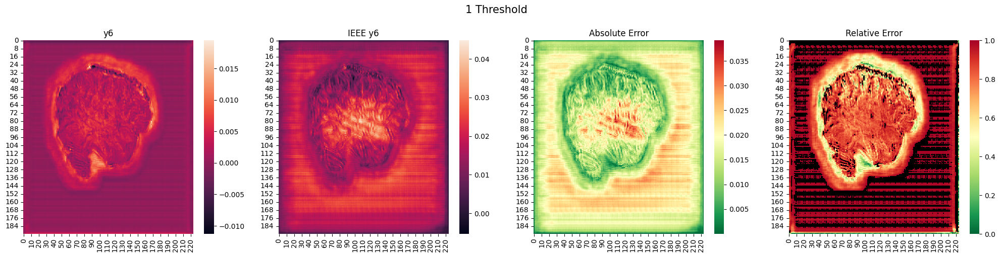

In [9]:
analyse_nan_all("1")

## 0.8 Threshold
Time: 671s = ~11min

Folder already exists


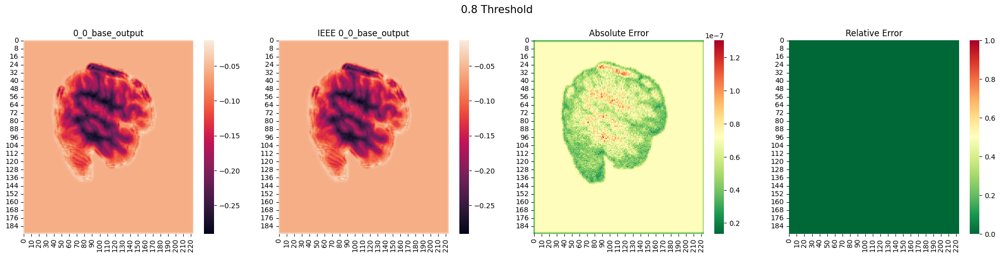

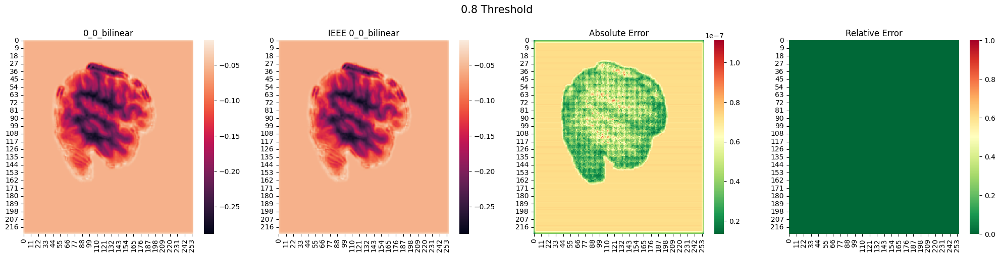

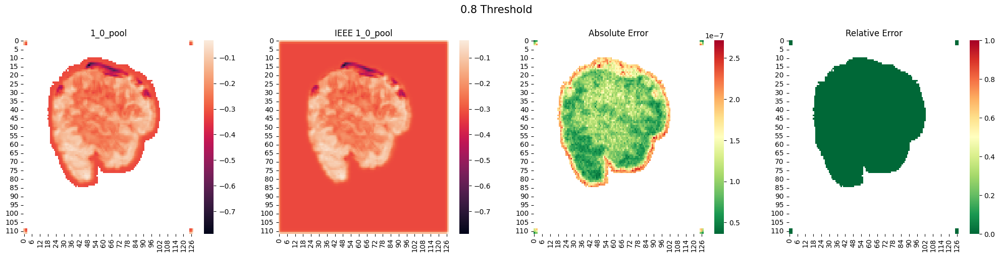

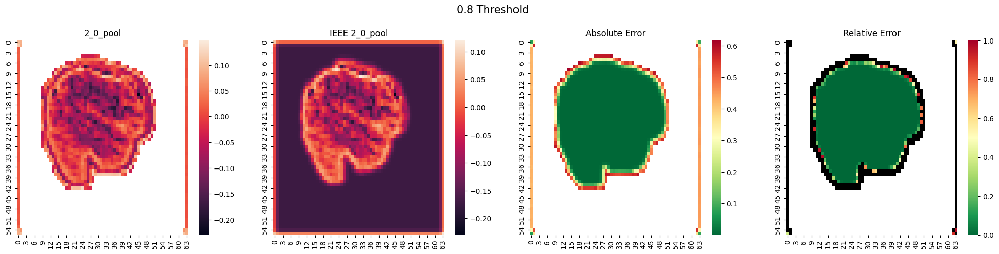

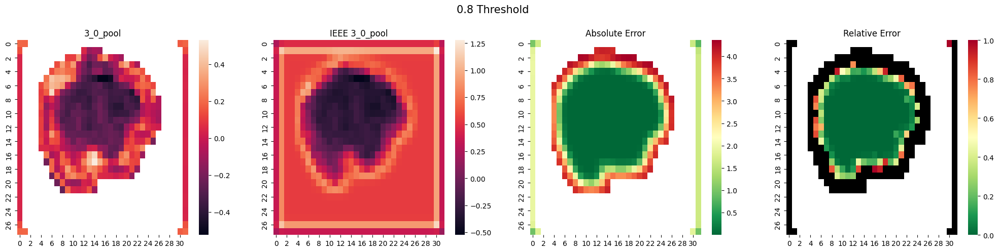

...

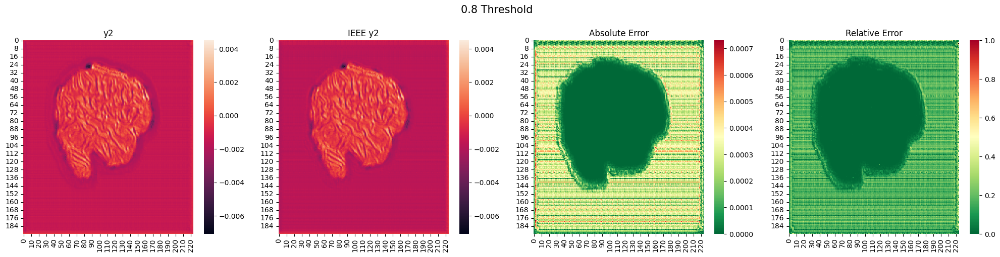

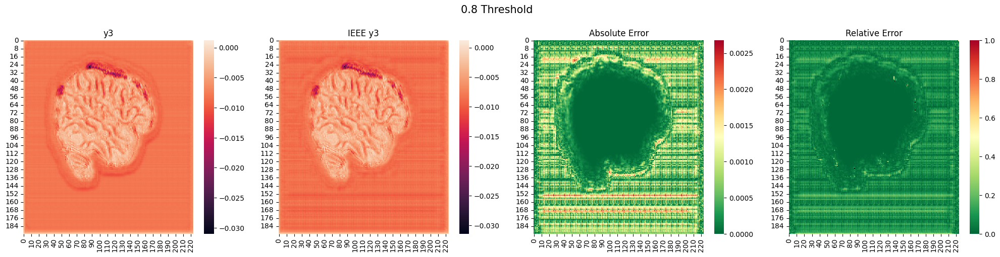

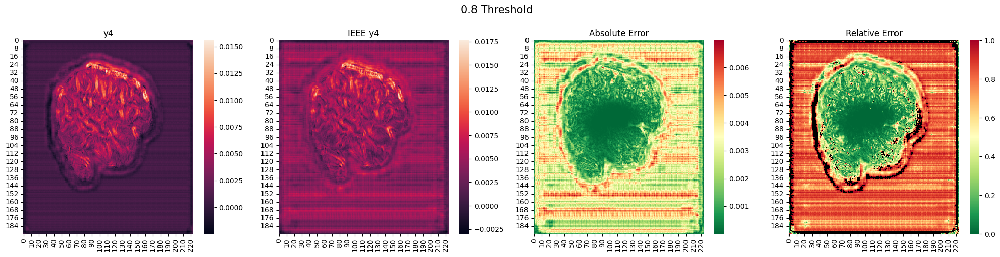

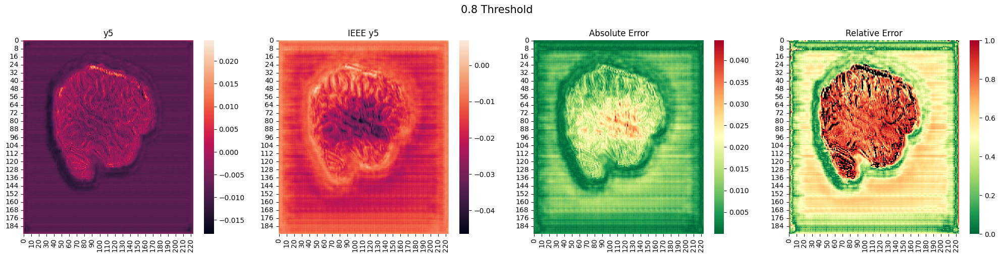

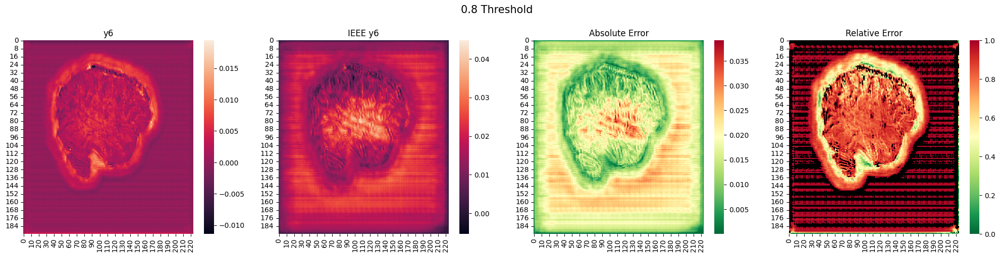

In [32]:
analyse_nan_all("0_8")

## 0.5 Threshold

Folder already exists


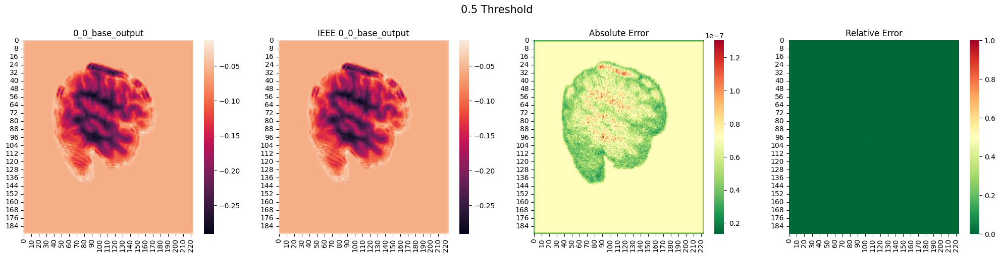

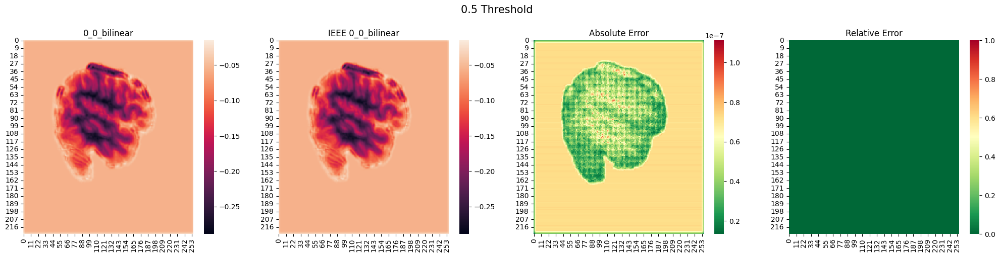

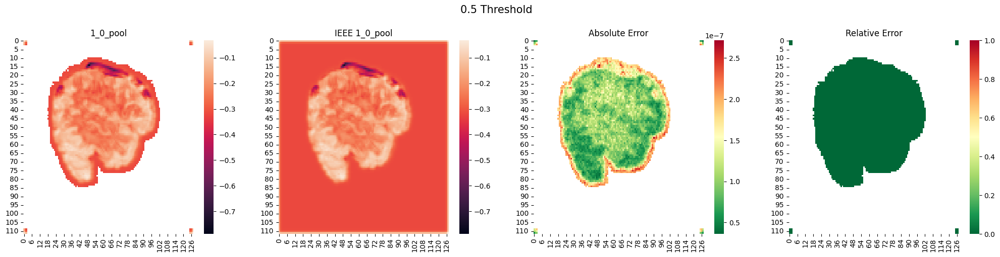

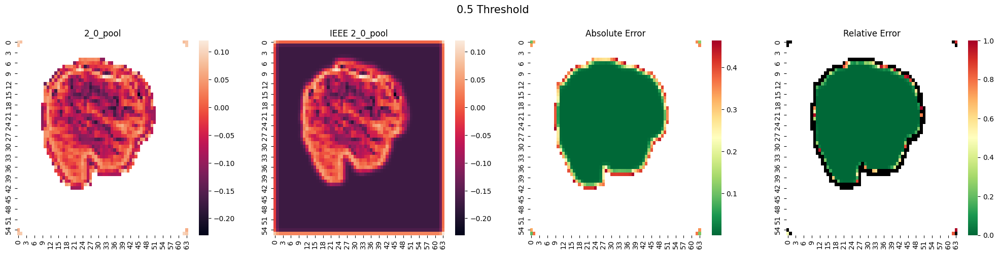

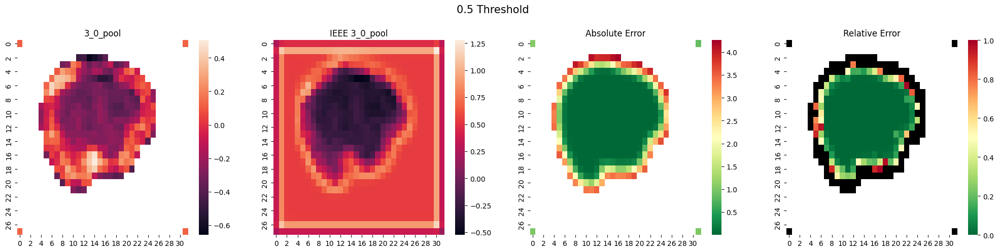

...

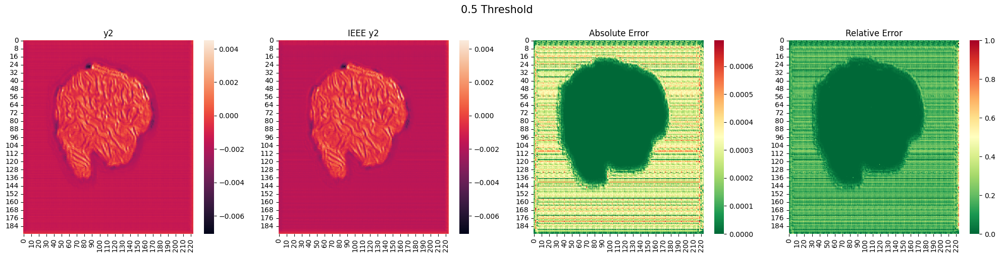

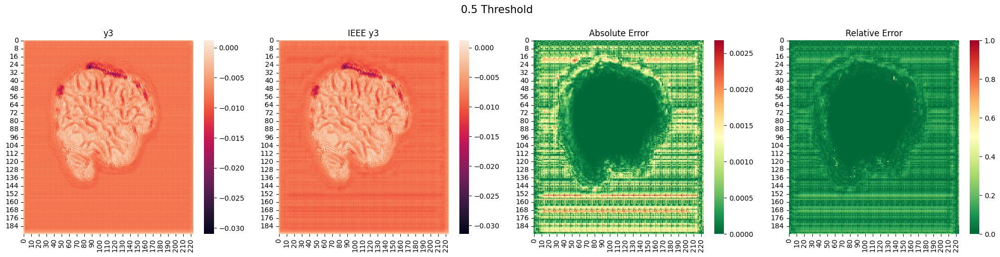

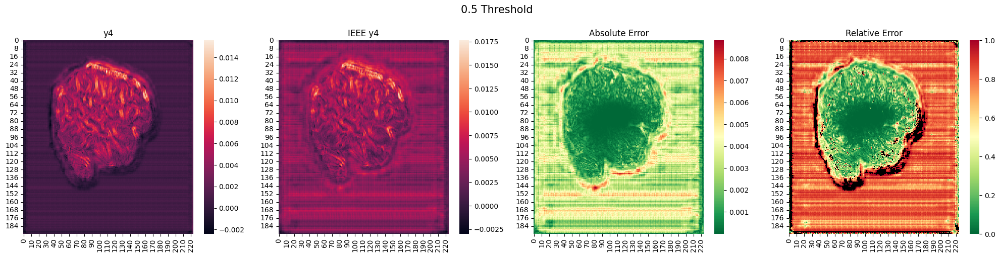

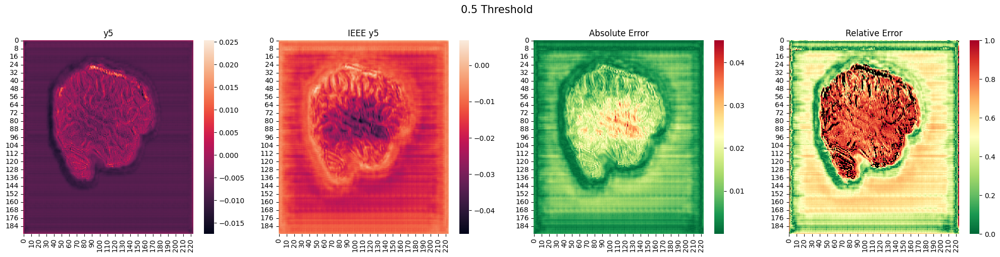

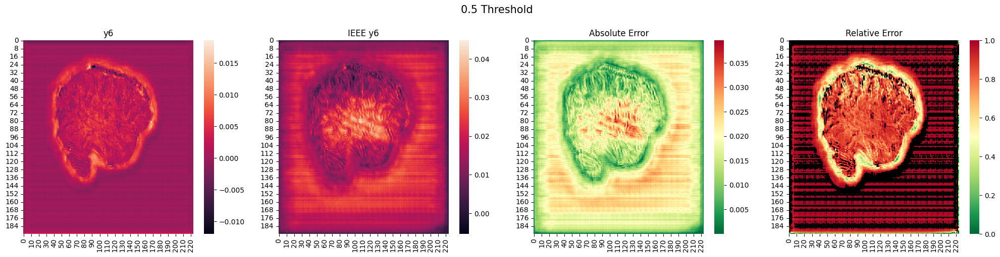

In [33]:
analyse_nan_all("0_5")

## 0.2 Threshold
Time: 572s = ~9min

Folder already exists


/usr/local/lib/python3.9/site-packages/seaborn/matrix.py:202: RuntimeWarning: All-NaN slice encountered
  vmin = np.nanmin(calc_data)
/usr/local/lib/python3.9/site-packages/seaborn/matrix.py:207: RuntimeWarning: All-NaN slice encountered
  vmax = np.nanmax(calc_data)


ValueError: Invalid vmin or vmax

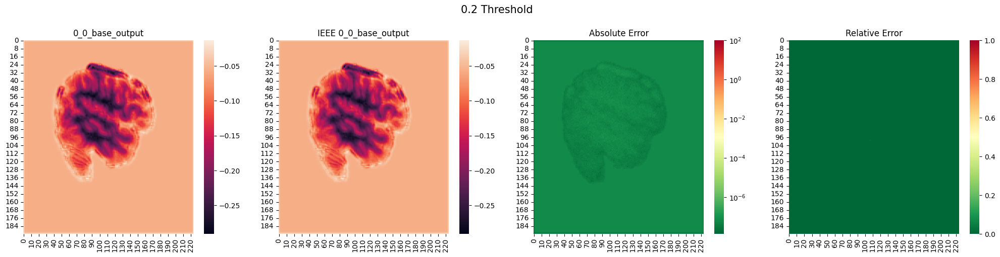

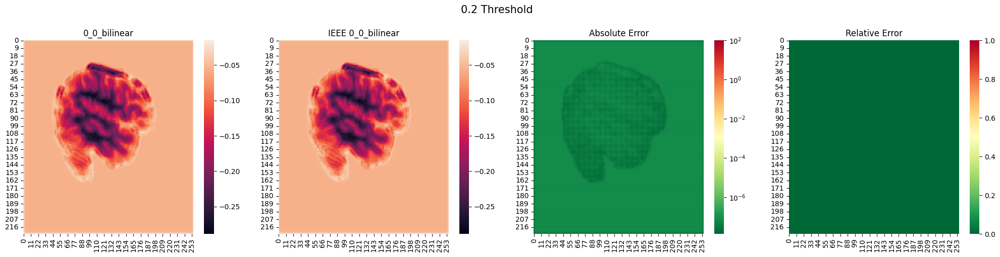

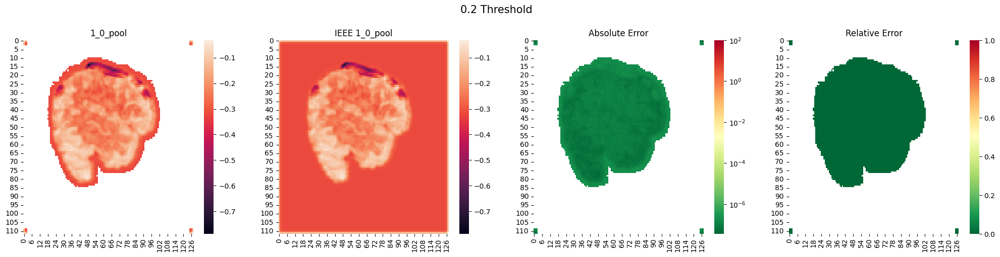

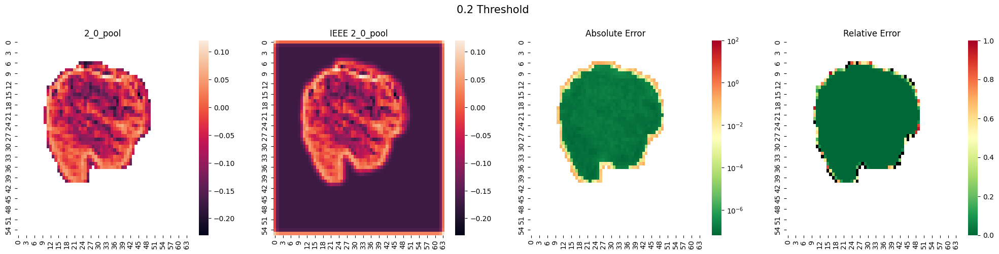

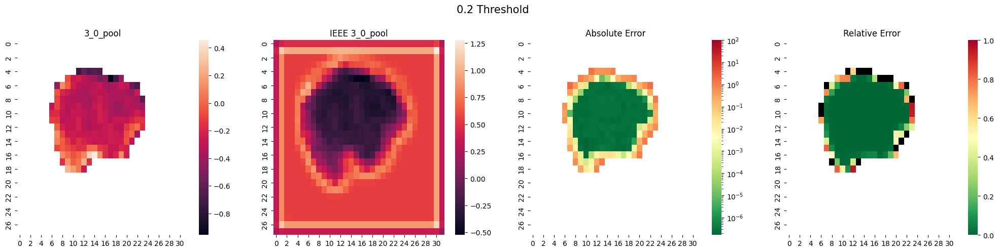

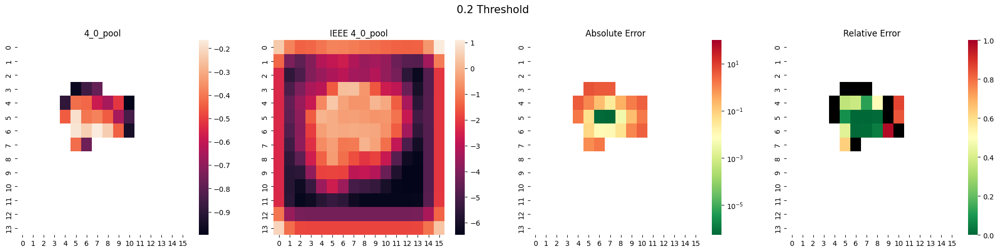

ValueError: Invalid vmin or vmax

<Figure size 2500x500 with 7 Axes>

In [3]:
analyse_nan_all("0_2")

# Skipped Convolutions

In [25]:
convs = ['0_0', '1_0', '0_1', '2_0', '1_1', '0_2', '3_0', '2_1', '1_2', '0_3', '4_0', '3_1', '2_2', '1_3', '0_4', '5_0', '4_1', '3_2', '2_3', '1_4', '0_5', '6_0', '5_1', '4_2', '3_3', '2_4', '1_5', '0_6', 'y1','y2','y3','y4','y5','y6']

def count_skipped_ops(filename):
    f = open(filename, 'r')

    skip_count = {}

    for line in f: 
        line = line.strip()
        if 'SKIP' in line:
            tmp = line.strip().split(':')
            count = tuple(map(int,tmp[1].strip().strip('()').split(', ')))
            name = tmp[2].strip()
            skip_count[name] = count
    comb_skip = {}
    for conv in convs[:-6]:
        comb_skip[conv] = []
        for i in range(0,3):
            comb_skip[conv].append(skip_count[f'{conv}_{i}'])
    for conv in convs[-6:]:
        comb_skip[conv] = skip_count[conv]
        
    return comb_skip
            
    
    


def aggregate_mean_ratios(dictionaries):
    # Initialize a dictionary to store aggregated ratio values for each convolutional layer
    aggregated_ratios = {}
    
    # Iterate through each dictionary
    for dictionary in dictionaries:
        # print(dictionary)

        for layer in dictionary:
            # Extract labels and ratio values
            labels = dictionary[layer].get('Labels', [])
            ratios = dictionary[layer].get('Ratio', [])

            if layer not in aggregated_ratios.keys(): 
                aggregated_ratios[layer] = {}
            
            # Iterate through labels and corresponding ratio values
            for label, ratio in zip(labels, ratios):
                # If label already exists in aggregated_ratios, add ratio value to list
                if label in aggregated_ratios[layer]:
                    aggregated_ratios[layer][label].append(ratio)
                # If label is new, initialize list with ratio value
                else:
                    aggregated_ratios[layer][label] = [ratio]
    
    # Calculate mean ratio for each convolutional layer
    mean_ratios = {}
    for layer in aggregated_ratios:
        mean_ratios[layer] = {}
        for label, ratios in aggregated_ratios[layer].items():
            mean_ratios[layer][label] = [sum(ratios) / len(ratios)]
    
    return aggregated_ratios, mean_ratios

def ratio_distribution(thresh1, thresh05):
    for block in ['Input', 'Encode1', 'Encode2', 'Encode3', 'Encode4', 'Bottleneck', 'Decode4', 'Decode3', 'Decode2', 'Decode1', 'Output block', 'Classifier']:
        fig, axes = plt.subplots(1, 2, figsize=(12,4))

        for conv in thresh1[block]:
            axes[0].scatter(np.arange(len(thresh1[block][conv])), thresh1[block][conv], alpha=0.5, label=conv)
            axes[1].scatter(np.arange(len(thresh05[block][conv])), thresh05[block][conv], alpha=0.5, label=conv)
            
        axes[0].legend(), axes[1].legend()
        axes[0].set_ylabel('NaN Ratio'), axes[1].set_ylabel('NaN Ratio')
        axes[0].set_title('Threshold 1'); axes[1].set_title('Threshold 0.5')
        plt.suptitle(f"{block} Mean NaN Ratio Distribution Across Sagittal View")
        # break


def average_block_ratio(mean_ratios_thresh1, mean_ratios_thresh05):
    # avg_thresh = {'0': [], '0.2': [], '0.5': [], '0.8': [], '1': []}
    avg_thresh = {'0.2': [], '0.5': [], '0.8': [], '1': []}
    avg_thresh = {'0.5': [], '1': []}

    for conv in convs:

        fig, axes = plt.subplots(1, 1, figsize=(10,5))
        # df1 = pd.DataFrame(thresh_0[block])
        # df1['Threshold'] = 0
        # df2 = pd.DataFrame(thresh_02[block])
        # df2['Threshold'] = 0.2
        df3 = pd.DataFrame(mean_ratios_thresh05[conv])
        df3 = df3.T.reset_index().rename(columns={'index':'Labels', 0:'Ratio'})
        df3['Threshold'] = 0.5
        # df4 = pd.DataFrame(thresh_08[block])
        # df4['Threshold'] = 0.8
        df5 = pd.DataFrame(mean_ratios_thresh1[conv])
        df5 = df5.T.reset_index().rename(columns={'index':'Labels', 0:'Ratio'})
        df5['Threshold'] = 1
        # df = pd.concat((df1, df2, df3, df4, df5))
        df = pd.concat((df3, df5))

        # avg_thresh['0'].append(np.mean(df1['Ratio']))
        # avg_thresh['0.2'].append(np.mean(df2['Ratio']))
        avg_thresh['0.5'].append(np.mean(df3['Ratio']))
        # avg_thresh['0.8'].append(np.mean(df4['Ratio']))
        avg_thresh['1'].append(np.mean(df5['Ratio']))


        gc = sns.barplot(x='Labels', y='Ratio', data=df, hue='Threshold', ax=axes)
        gc.set_title(conv), sns.move_legend(axes, "upper left", bbox_to_anchor=(1, 1));

    fig, axes = plt.subplots(1, 1, figsize=(10,5))


    avg_thresh = pd.DataFrame(avg_thresh)
    # axes.plot(avg_thresh['0'], marker='o', alpha=0.5, label = 'Threshold 0')
    # axes.plot(avg_thresh['0.2'], marker='o', alpha=0.5, label = 'Threshold 0.2')
    axes.plot(avg_thresh['0.5'], marker='o', alpha=0.5, label = 'Threshold 0.5')
    # axes.plot(avg_thresh['0.8'], marker='o', alpha=0.5, label = 'Threshold 0.8')
    axes.plot(avg_thresh['1'], marker='o', alpha=0.5, label = 'Threshold 1')
    axes.set_title('Mean Skipped Count Operations Across Model'), axes.legend(loc="upper left", bbox_to_anchor=(1, 1));
    axes.set_xticks(np.arange(len(mean_ratios_thresh1.keys())), list(mean_ratios_thresh1.keys()), rotation=30);



In [26]:
#Average of 3 conv
count_skipped_ops("nan_0_5.out")

{'0_0': [(0, 2752512), (0, 2752512), (0, 2752512)],
 '1_0': [(0, 3670016), (0, 3670016), (0, 3670016)],
 '0_1': [(0, 2752512), (0, 2752512), (0, 2752512)],
 '2_0': [(606912, 917504), (608256, 917504), (610620, 917504)],
 '1_1': [(0, 3670016), (0, 3670016), (0, 3670016)],
 '0_2': [(0, 2752512), (0, 2752512), (0, 2752512)],
 '3_0': [(149504, 229376), (149504, 229376), (149568, 229376)],
 '2_1': [(609152, 917504), (609152, 917504), (609216, 917504)],
 '1_2': [(0, 3670016), (0, 3670016), (0, 3670016)],
 '0_3': [(0, 2752512), (0, 2752512), (0, 2752512)],
 '4_0': [(35776, 57344), (35776, 57344), (35776, 57344)],
 '3_1': [(149632, 229376), (149632, 229376), (149696, 229376)],
 '2_2': [(609280, 917504), (609408, 917504), (609579, 917504)],
 '1_3': [(0, 3670016), (0, 3670016), (0, 3670016)],
 '0_4': [(0, 2752512), (0, 2752512), (0, 2752512)],
 '5_0': [(7616, 14336), (7616, 14336), (7744, 14336)],
 '4_1': [(35776, 57344), (35776, 57344), (35776, 57344)],
 '3_2': [(149632, 229376), (149632, 22937

In [ ]:
# out = nib.load(os.path.join('/workspaces/FONDUE/embeddings_project/sub-0025531_FONDUE_LT.nii.gz'))
ROOT = '/workspaces/FONDUE/embeddings/ieee_axial'
# fig, axes = plt.subplots(2, 6, figsize=(30,5))
# for i in range(0,6):
#   out = pickle.load(open(os.path.join(f'/workspaces/FONDUE/nan_skip_0_5/nan_skip_0_5_axial/y{i+1}.pkl'), 'rb'))
#   gc = sns.heatmap(np.mean(out.detach().numpy().squeeze(), axis=0), ax=axes[i])
#   gc.set_title(f'Y{i+1}')

# plt.suptitle(f"Nan 0.5 Y Output", y=1.02, fontsize=15)

fig, axes = plt.subplots(2, 6, figsize=(30,8))
for i in range(0,6):
  out = pickle.load(open(os.path.join(f'{ROOT}/y{i+1}.pkl'), 'rb'))
  gc = sns.heatmap(np.mean(out.detach().numpy().squeeze(), axis=0), ax=axes[0,i])
  gc.set_title(f'Y{i+1}')


for i in range(0,6):
  out = pickle.load(open(os.path.join(f'/workspaces/FONDUE/nan_skip_0_5/nan_skip_0_5_axial/y{i+1}.pkl'), 'rb'))
  gc = sns.heatmap(np.mean(out.detach().numpy().squeeze(), axis=0), ax=axes[1,i])
  gc.set_title(f'Y{i+1}')

plt.suptitle(f"IEEE vs NaN Y Output", y=1.02, fontsize=15)

fig, axes = plt.subplots(2, 6, figsize=(30,8))
for i in range(0,6):
  out = pickle.load(open(os.path.join(f'{ROOT}/1_{i}_bilinear.pkl'), 'rb'))[1]
  gc = sns.heatmap(np.mean(out.detach().numpy().squeeze(), axis=0), ax=axes[0,i])
  gc.set_title(f'1_{i}_bilinear')


for i in range(0,6):
  out = pickle.load(open(os.path.join(f'/workspaces/FONDUE/nan_skip_0_5/nan_skip_0_5_axial/1_{i}_bilinear.pkl'), 'rb'))[1]
  gc = sns.heatmap(np.mean(out.detach().numpy().squeeze(), axis=0), ax=axes[1,i])
  gc.set_title(f'1_{i}_bilinear')

plt.suptitle(f"IEEE vs NaN Interpolation Output", y=1.02, fontsize=15)

fig, axes = plt.subplots(1, 5, figsize=(25,5))
for i in range(0,5):
  out = pickle.load(open(os.path.join(f'{ROOT}/2_{i}_unpool.pkl'), 'rb'))[1]
  gc = sns.heatmap(np.mean(out.detach().numpy().squeeze(), axis=0), ax=axes[i])
  gc.set_title(f'2_{i}_unpool')

plt.suptitle(f"2_x Unpool Output", y=1.02, fontsize=15)


fig, axes = plt.subplots(1, 4, figsize=(20,5))
for i in range(0,4):
  out = pickle.load(open(os.path.join(f'{ROOT}/3_{i}_unpool.pkl'), 'rb'))[1]
  gc = sns.heatmap(np.mean(out.detach().numpy().squeeze(), axis=0), ax=axes[i])
  gc.set_title(f'3_{i}_unpool')

plt.suptitle(f"3_x Unpool Output", y=1.02, fontsize=15)


fig, axes = plt.subplots(1, 3, figsize=(15,5))
for i in range(0,3):
  out = pickle.load(open(os.path.join(f'{ROOT}/4_{i}_unpool.pkl'), 'rb'))[1]
  gc = sns.heatmap(np.mean(out.detach().numpy().squeeze(), axis=0), ax=axes[i])
  gc.set_title(f'4_{i}_unpool')

plt.suptitle(f"4_x Unpool Output", y=1.02, fontsize=15)

fig, axes = plt.subplots(1, 2, figsize=(10,5))
for i in range(0,2):
  out = pickle.load(open(os.path.join(f'{ROOT}/5_{i}_unpool.pkl'), 'rb'))[1]
  gc = sns.heatmap(np.mean(out.detach().numpy().squeeze(), axis=0), ax=axes[i])
  gc.set_title(f'5_{i}_unpool')

plt.suptitle(f"5_x Unpool Output", y=1.02, fontsize=15)

fig, axes = plt.subplots(1, 1, figsize=(5,5))
out = pickle.load(open(os.path.join(f'{ROOT}/6_0_unpool.pkl'), 'rb'))[1]
gc = sns.heatmap(np.mean(out.detach().numpy().squeeze(), axis=0), ax=axes)
gc.set_title(f'6_0_unpool')

plt.suptitle(f"6_0 Unpool Output", y=1.02, fontsize=15)

In [ ]:
ROOT = '/workspaces/FONDUE/nan_skip_0_5/nan_skip_0_5_axial'
fig, axes = plt.subplots(1, 6, figsize=(30,5))
for i in range(0,6):
  out = pickle.load(open(os.path.join(f'{ROOT}/y{i+1}.pkl'), 'rb'))
  gc = sns.heatmap(np.mean(out.detach().numpy().squeeze(), axis=0), ax=axes[i])
  gc.set_title(f'Y{i+1}')

plt.suptitle(f"NaN 0.5 Y Output", y=1.02, fontsize=15)

fig, axes = plt.subplots(1, 6, figsize=(30,5))
for i in range(0,6):
  out = pickle.load(open(os.path.join(f'{ROOT}/1_{i}_bilinear.pkl'), 'rb'))[1]
  gc = sns.heatmap(np.mean(out.detach().numpy().squeeze(), axis=0), ax=axes[i])
  gc.set_title(f'1_{i}_bilinear')

plt.suptitle(f"NaN 0.5 Interpolation Output", y=1.02, fontsize=15)

fig, axes = plt.subplots(1, 5, figsize=(25,5))
for i in range(0,5):
  out = pickle.load(open(os.path.join(f'{ROOT}/2_{i}_unpool.pkl'), 'rb'))[1]
  gc = sns.heatmap(np.mean(out.detach().numpy().squeeze(), axis=0), ax=axes[i])
  gc.set_title(f'2_{i}_unpool')

plt.suptitle(f"NaN 0.5 2_x Unpool Output", y=1.02, fontsize=15)


fig, axes = plt.subplots(1, 4, figsize=(20,5))
for i in range(0,4):
  out = pickle.load(open(os.path.join(f'{ROOT}/3_{i}_unpool.pkl'), 'rb'))[1]
  gc = sns.heatmap(np.mean(out.detach().numpy().squeeze(), axis=0), ax=axes[i])
  gc.set_title(f'3_{i}_unpool')

plt.suptitle(f"NaN 0.5 3_x Unpool Output", y=1.02, fontsize=15)


fig, axes = plt.subplots(1, 3, figsize=(15,5))
for i in range(0,3):
  out = pickle.load(open(os.path.join(f'{ROOT}/4_{i}_unpool.pkl'), 'rb'))[1]
  gc = sns.heatmap(np.mean(out.detach().numpy().squeeze(), axis=0), ax=axes[i])
  gc.set_title(f'4_{i}_unpool')

plt.suptitle(f"NaN 0.5 4_x Unpool Output", y=1.02, fontsize=15)

fig, axes = plt.subplots(1, 2, figsize=(10,5))
for i in range(0,2):
  out = pickle.load(open(os.path.join(f'{ROOT}/5_{i}_unpool.pkl'), 'rb'))[1]
  gc = sns.heatmap(np.mean(out.detach().numpy().squeeze(), axis=0), ax=axes[i])
  gc.set_title(f'5_{i}_unpool')

plt.suptitle(f"NaN 0.5 5_x Unpool Output", y=1.02, fontsize=15)

fig, axes = plt.subplots(1, 1, figsize=(5,5))
out = pickle.load(open(os.path.join(f'{ROOT}/6_0_unpool.pkl'), 'rb'))[1]
gc = sns.heatmap(np.mean(out.detach().numpy().squeeze(), axis=0), ax=axes)
gc.set_title(f'6_0_unpool')

plt.suptitle(f"NaN 0.5 6_0 Unpool Output", y=1.02, fontsize=15)

Text(0.5, 1.02, 'Output')

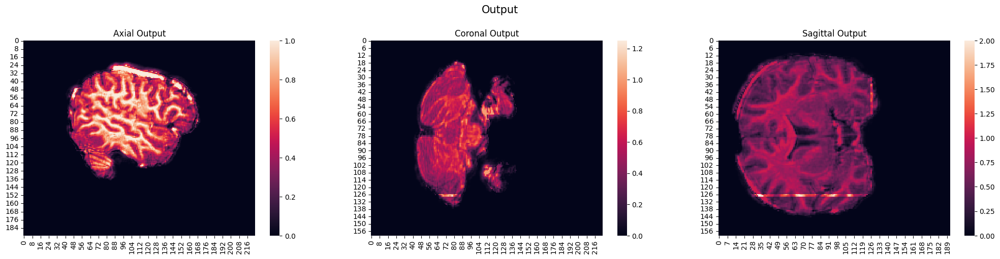

In [21]:
fig, axes = plt.subplots(1, 3, figsize=(25,5))
ROOT = '/workspaces/FONDUE/nan_skip_0_5'
out = pickle.load(open(os.path.join(f'{ROOT}/axial.pkl'), 'rb'))
gc = sns.heatmap(out.detach().numpy()[127,:,:,:].squeeze(), ax=axes[0])
gc.set_title(f'Axial Output')

out = pickle.load(open(os.path.join(f'{ROOT}/coronal.pkl'), 'rb'))
gc = sns.heatmap(out.detach().numpy()[:,127,:,:].squeeze(), ax=axes[1])
gc.set_title(f'Coronal Output')

out = pickle.load(open(os.path.join(f'{ROOT}/sagittal.pkl'), 'rb'))
gc = sns.heatmap(out.detach().numpy()[:,:,127,:].squeeze(), ax=axes[2])
gc.set_title(f'Sagittal Output')

# out = pickle.load(open(os.path.join(f'{ROOT}/mean.pkl'), 'rb'))
# gc = sns.heatmap(out.detach().numpy()[:,:,127,:].squeeze(), ax=axes[3])
# gc.set_title(f'Mean Output')
plt.suptitle(f"Output", y=1.02, fontsize=15)

In [4]:
def calculate_local_snr(image, patch_size=3):
    """
    Calculate the local SNR of a 2D brain slice image using scipy.ndimage.
    
    Parameters:
    - image: 2D NumPy array, the brain slice image
    - patch_size: int, the size of the patches to divide the image into
    
    Returns:
    - snr_map: 2D NumPy array, the local SNR values
    """
    # Ensure the image is a 2D array
    if len(image.shape) != 2:
        raise ValueError("Input image must be a 2D array.")
    # Calculate local mean
    local_mean = ndimage.uniform_filter(image, size=patch_size)
    
    # Calculate local squared mean
    local_sq_mean = ndimage.uniform_filter(image**2, size=patch_size)
    
    # Calculate local variance (E[X^2] - (E[X])^2)
    local_variance = local_sq_mean - local_mean**2
    
    # Calculate local standard deviation
    local_std = np.sqrt(local_variance)
    
    # Avoid division by zero
    local_std[local_std == 0] = np.finfo(float).eps
    
    # Calculate local SNR (mean / std)
    snr_map = local_mean / local_std
    
    return np.abs(snr_map)

In [17]:
def plot_final_compare(nan_out, ieee_single, ieee_whole, base, nan_thresh):
    fig, axes = plt.subplots(2, 4, figsize=(30,10))

    out = nib.load(os.path.join(nan_out)).get_fdata()
    gc = sns.heatmap(out[:,:,127].squeeze(), ax=axes[0][0])
    gc.set_title(f'NaN {nan_thresh} Output')
    gc.set_ylabel("Axial View")

    out = nib.load(os.path.join(ieee_single)).get_fdata()
    gc = sns.heatmap(out[:,:,127].squeeze(), ax=axes[0][1])
    gc.set_title(f'IEEE Single Segment Output')

    out = nib.load(os.path.join(ieee_whole)).get_fdata()
    gc = sns.heatmap(out[:,:,127].squeeze(), ax=axes[0][2])
    gc.set_title(f'IEEE Whole Brain Output')

    out = nib.load(os.path.join(base)).get_fdata()
    gc = sns.heatmap(out[:,:,127].squeeze(), ax=axes[0][3])
    gc.set_title(f'Original MRI')

    snr = lambda  x : x.mean()/x.std()

    out = nib.load(os.path.join(nan_out)).get_fdata()
    gc = sns.heatmap(calculate_local_snr(out[:,:,127]), ax=axes[1][0], vmin=0, vmax=200)
    gc.set_title(f'NaN {nan_thresh} Output - Global SNR: {snr(out[:,:,127])}')
    gc.set_ylabel("Local SNR")

    out = nib.load(os.path.join(ieee_single)).get_fdata()
    gc = sns.heatmap(calculate_local_snr(out[:,:,127]), ax=axes[1][1], vmin=0, vmax=200)
    gc.set_title(f'IEEE Single Segment Output - Global SNR: {snr(out[:,:,127])}')

    out = nib.load(os.path.join(ieee_whole)).get_fdata()
    gc = sns.heatmap(calculate_local_snr(out[:,:,127]), ax=axes[1][2], vmin=0, vmax=200)
    gc.set_title(f'IEEE Whole Brain Output - Global SNR: {snr(out[:,:,127])}')

    out = nib.load(os.path.join(base)).get_fdata()
    gc = sns.heatmap(calculate_local_snr(out[:,:,127]), ax=axes[1][3], vmin=0, vmax=200)
    gc.set_title(f'Original MRI - Global SNR: {snr(out[:,:,127])}')

    plt.suptitle(f"Final Denoised Image Comparison", y=1.02, fontsize=15)

/tmp/ipykernel_3448/2725765609.py:25: RuntimeWarning: invalid value encountered in sqrt
  local_std = np.sqrt(local_variance)


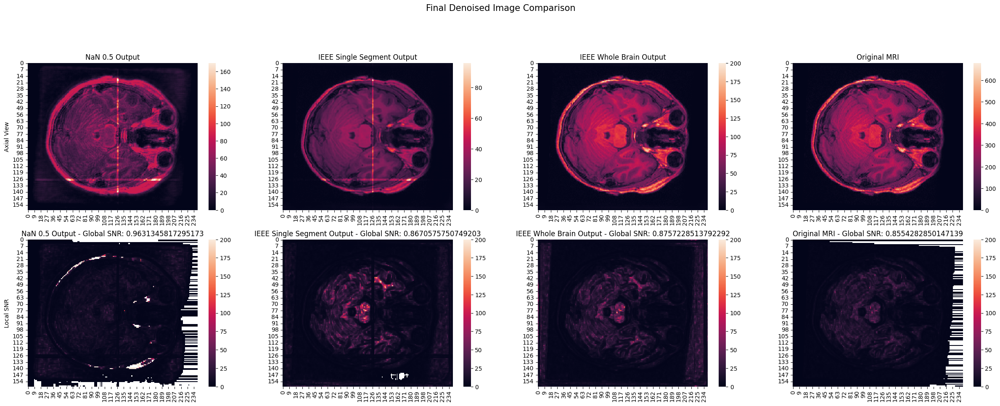

In [11]:
plot_final_compare('/workspaces/FONDUE/out_nan_0_5.gz', '/workspaces/FONDUE/sub-0025531_ses-1_run-1_T1w_single_FONDUE_LT.nii.gz', '/workspaces/FONDUE/sub-0025531_ses-1_run-1_T1w_FONDUE_LT.nii.gz', '/workspaces/FONDUE/sub-0025531_ses-1_run-1_T1w.nii.gz', 0.5)

/tmp/ipykernel_3448/2725765609.py:25: RuntimeWarning: invalid value encountered in sqrt
  local_std = np.sqrt(local_variance)


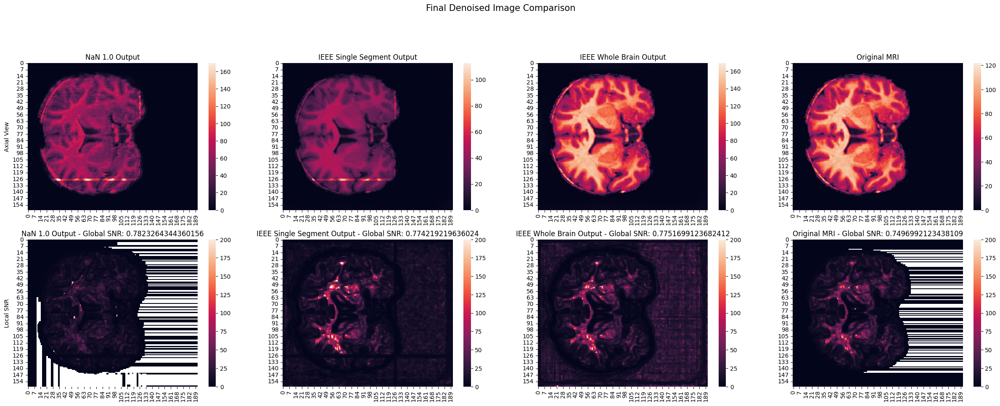

In [19]:
plot_final_compare('/workspaces/FONDUE/out_nan_1_0.nii.gz', '/workspaces/FONDUE/embeddings_project/sub-0025531_FONDUE_LT_single.nii.gz', '/workspaces/FONDUE/embeddings_project/sub-0025531_FONDUE_LT_whole.nii.gz', '/workspaces/FONDUE/embeddings_project/sub-0025531.nii.gz', 1.0)


/tmp/ipykernel_23132/340213279.py:2: RuntimeWarning: divide by zero encountered in divide
  rel = lambda a, ieee : np.abs((a - ieee)/ieee)
/tmp/ipykernel_23132/340213279.py:2: RuntimeWarning: invalid value encountered in divide
  rel = lambda a, ieee : np.abs((a - ieee)/ieee)


Text(0.5, 1.02, 'Denoised Image Comparison - Relative error Axial')

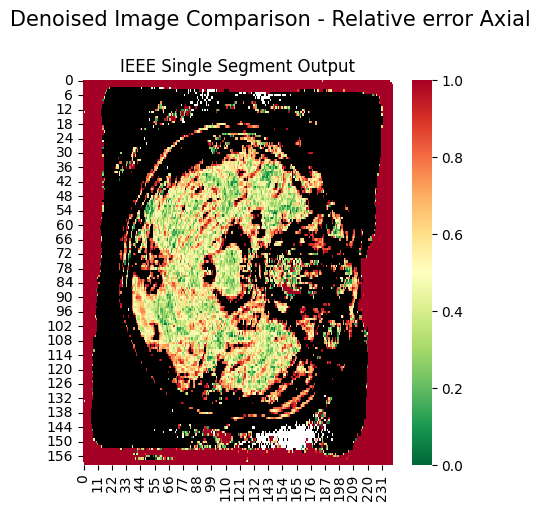

In [19]:
fig, axes = plt.subplots(1, 1, figsize=(5,5))
rel = lambda a, ieee : np.abs((a - ieee)/ieee)
cmap = matplotlib.colormaps['RdYlGn_r'].with_extremes(under='white', over='black')  
a = nib.load(os.path.join(f'/workspaces/FONDUE/nan_out.nii.gz')).get_fdata()
ieee = nib.load(os.path.join(f'/workspaces/FONDUE/ieee_out_single.nii.gz')).get_fdata()
gc = sns.heatmap(rel(a[:,:,127], ieee[:,:,127]), ax=axes, vmin=0, vmax=1, cmap = cmap)
gc.set_title(f'IEEE Single Segment Output')

plt.suptitle(f"Denoised Image Comparison - Relative error Axial", y=1.02, fontsize=15)

In [3]:
def graph_arch(graph_func, name, cmap, ieee_root, nan_root, min = None, max = None):
    num_rows = 8
    padding = 0.02

    # Create a figure
    fig = plt.figure(figsize=(30, 25))

    num_cols = 6
    total_width = num_cols / num_rows
    total_width_with_padding = total_width + (num_cols - 1) * padding
    left_start = (1 - total_width_with_padding) / 2
    for col in range(6):
        # Calculate the subplot position with padding
        left = left_start + col * (1 / num_rows + padding)
        bottom = (num_rows  - 1) / num_rows  # Reverse the row position
        width = 1 / num_rows - padding
        height = 1 / num_rows - padding
        
        # Add subplot with the calculated position
        ax = fig.add_axes([left, bottom, width, height])
        ax.set_visible(True)

    # Plot heatmaps in a reverse pyramid shape with padding
    for row in range(num_rows):
        if row != 0:
            num_cols = num_rows - row
            total_width = num_cols / num_rows
            total_width_with_padding = total_width + (num_cols - 1) * padding
            left_start = (1 - total_width_with_padding) / 2
            
            for col in range(num_cols):
                # Calculate the subplot position with padding
                left = left_start + col * (1 / num_rows + padding)
                bottom = (num_rows - row - 1) / num_rows  # Reverse the row position
                width = 1 / num_rows - padding
                height = 1 / num_rows - padding
                
                # Add subplot with the calculated position
                ax = fig.add_axes([left, bottom, width, height])
                ax.set_visible(True)
                

    idx =0
    for i in range(1,7):
        a=pickle.load(open(f'{nan_root}/y{i}.pkl', 'rb'))[0]
        ieee=pickle.load(open(f'{ieee_root}/y{i}.pkl', 'rb'))
        # diff_rel = diff_rel.nan_to_num(nan=-1, posinf=2)
        gc = sns.heatmap(graph_func(a, ieee), cmap=cmap, ax=fig.axes[idx], vmin=min, vmax=max)
        
        gc.set_title(f'y{i}')
        idx += 1


    a=pickle.load(open(f'{nan_root}/0_0_base_output.pkl', 'rb'))[0]
    ieee=pickle.load(open(f'{ieee_root}/0_0_base_output.pkl', 'rb'))[0]
    diff_abs = torch.abs(a - ieee) 
    diff_rel = torch.abs((a - ieee)/ieee)
    # diff_rel = diff_rel.nan_to_num(nan=-1, posinf=2)
    gc = sns.heatmap(graph_func(a, ieee), cmap=cmap, ax=fig.axes[idx], vmin=min, vmax=max)
    
    gc.set_title(f'0_0_base_output')
    idx += 1

    for i in range(6):
        a=pickle.load(open(f'{nan_root}/1_{i}_bilinear.pkl', 'rb'))[0]
        ieee=pickle.load(open(f'{ieee_root}/1_{i}_bilinear.pkl', 'rb'))[0]
        diff_abs = torch.abs(a - ieee) 
        diff_rel = torch.abs((a - ieee)/ieee)
        # diff_rel = diff_rel.nan_to_num(nan=-1, posinf=2)
        gc = sns.heatmap(graph_func(a, ieee), cmap=cmap, ax=fig.axes[idx], vmin=min, vmax=max)
        gc.set_title(f'1_{i}_bilinear')
        idx += 1


    for i in range(1,6):
        a=pickle.load(open(f'{nan_root}/{i}_0_pool.pkl', 'rb'))[0]
        ieee=pickle.load(open(f'{ieee_root}/{i}_0_pool.pkl', 'rb'))[0]
        diff_abs = torch.abs(a - ieee) 
        diff_rel = torch.abs((a - ieee)/ieee)
        # diff_rel = diff_rel.nan_to_num(nan=-1, posinf=2)
        gc = sns.heatmap(graph_func(a, ieee), cmap=cmap, ax=fig.axes[idx], vmin=min, vmax=max)
        
        gc.set_title(f'{i}_0_pool')
        idx += 1
        for j in range(6-i):
            a=pickle.load(open(f'{nan_root}/{i+1}_{j}_unpool.pkl', 'rb'))[0]
            ieee=pickle.load(open(f'{ieee_root}/{i+1}_{j}_unpool.pkl', 'rb'))[0]
            gc = sns.heatmap(graph_func(a, ieee), cmap=cmap, ax=fig.axes[idx], vmin=min, vmax=max)
            
            gc.set_title(f'{i+1}_{j}_unpool')
            idx += 1
    fig.axes[idx].set_visible(False)

    plt.suptitle(name, y=1.02, fontsize=15);
    # Show the plot
    plt.show()


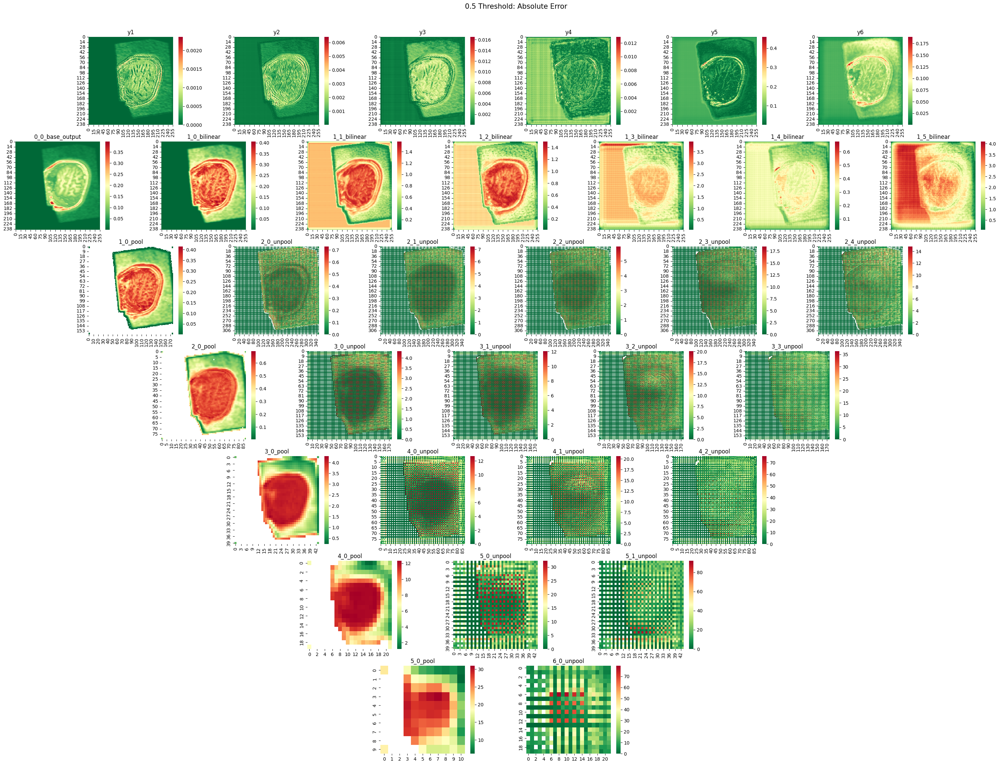

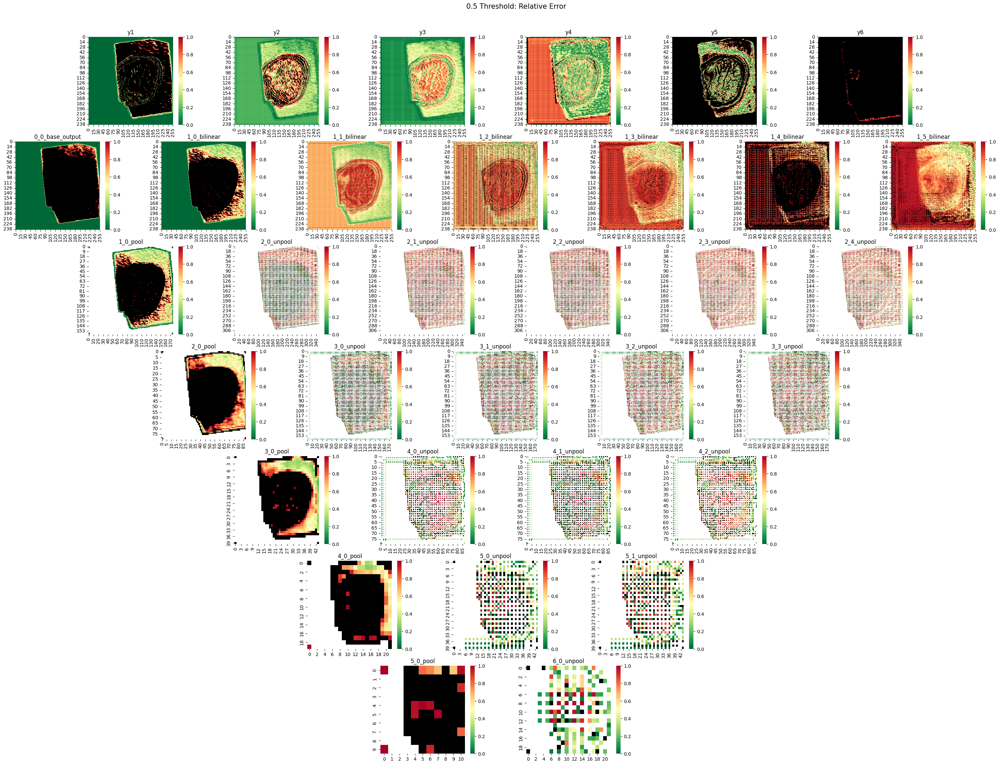

In [20]:
abs = lambda a, ieee : np.mean(torch.abs(a - ieee).detach().numpy().squeeze(), axis=0)
rel = lambda a, ieee : np.mean(torch.abs((a - ieee)/ieee).nan_to_num(nan=-1, posinf=2).detach().numpy().squeeze(), axis=0)
# gc = sns.heatmap(calculate_local_snr(a[0]), 
nan_root = '/workspaces/FONDUE/embeddings/nan_0_5_axial'
ieee_root = '/workspaces/FONDUE/embeddings/ieee_axial' 
cmap = matplotlib.colormaps['RdYlGn_r'].with_extremes(under='white', over='black')    
graph_arch(abs, '0.5 Threshold: Absolute Error', cmap, ieee_root, nan_root)
graph_arch(rel, '0.5 Threshold: Relative Error', cmap, ieee_root, nan_root, min=0, max=1)

In [154]:
# def graph_cmp(a, ieee, fig, name):
#     axes = fig.subplots(1,4)
#     diff_abs = torch.abs(a - ieee) 
#     diff_rel = torch.abs((a - ieee)/ieee)
        
#     gc = sns.heatmap(np.mean(a.detach().numpy().squeeze(), axis=0), ax=axes[0])
#     gc.set_title(f'NaN {name}')

#     gc = sns.heatmap(np.mean(ieee.detach().numpy().squeeze(), axis=0), ax=axes[1])
#     gc.set_title(f'IEEE {name}')

#     gc = sns.heatmap(np.mean(diff_abs.detach().numpy().squeeze(), axis=0), cmap='RdYlGn_r', ax=axes[2])
#     gc.set_title(f'Absolute Error')

#     diff_rel = diff_rel.nan_to_num(nan=-1, posinf=2)
#     cmap = matplotlib.colormaps['RdYlGn_r'].with_extremes(under='white', over='black')
#     gc = sns.heatmap(np.mean(diff_rel.detach().numpy().squeeze(), axis=0),  cmap=cmap, vmin=0, vmax=1.0, ax=axes[3])
#     gc.set_title(f'Relative Error')

#     # plt.suptitle(f"{thresh.replace('_','.')} Threshold", y=1.02, fontsize=15);
#     plt.suptitle(f"1.0 Threshold", y=1.02, fontsize=15);

# def cmp_thresh_to_ieee(name, cmap, ieee_root, nan_root, min = None, max = None):
#     fig = plt.figure(figsize=(20,5))
#     rows = fig.subfigures(6, 1)
#     idx = 0
#     for i in range(1,7):
#         a=pickle.load(open(f'{nan_root}/y{i}.pkl', 'rb'))
#         ieee=pickle.load(open(f'{ieee_root}/y{i}.pkl', 'rb'))
#         graph_cmp(a, ieee, rows[idx], f'y{i}')
#         idx += 1
#     plt.show()

#     rows = fig.subfigures(7, 1)
#     idx =0
#     a=pickle.load(open(f'{nan_root}/0_0_base_output.pkl', 'rb'))[0]
#     ieee=pickle.load(open(f'{ieee_root}/0_0_base_output.pkl', 'rb'))[0]
#     graph_cmp(a, ieee, rows[idx], f'0_0_base_output')
#     idx += 1

#     for i in range(6):
#         a=pickle.load(open(f'{nan_root}/1_{i}_bilinear.pkl', 'rb'))[0]
#         ieee=pickle.load(open(f'{ieee_root}/1_{i}_bilinear.pkl', 'rb'))[0]
#         graph_cmp(a, ieee, rows[idx], f'1_{i}_bilinear')    
#         idx += 1
#     plt.show()

#     for i in range(1,6):
#         idx=0
#         rows = fig.subfigures(7, 1)
#         a=pickle.load(open(f'{nan_root}/{i}_0_pool.pkl', 'rb'))[0]
#         ieee=pickle.load(open(f'{ieee_root}/{i}_0_pool.pkl', 'rb'))[0]
#         graph_cmp(a, ieee, rows[idx], f'{i}_0_pool')    
#         idx += 1
#         for j in range(6-i):
#             a=pickle.load(open(f'{nan_root}/{i+1}_{j}_unpool.pkl', 'rb'))[0]
#             ieee=pickle.load(open(f'{ieee_root}/{i+1}_{j}_unpool.pkl', 'rb'))[0]
#             graph_cmp(a, ieee, rows[idx], f'{i+1}_{j}_unpool')    
#             idx += 1
#         plt.show()
        
#     fig.axes[idx].set_visible(False)

#     plt.suptitle(name, y=1.02, fontsize=15);
#     # Show the plot
#     plt.show()
layers = [
        '0_0_base_output', '0_0_bilinear', '1_0_bilinear', '1_1_bilinear', '1_2_bilinear', '1_3_bilinear', '1_4_bilinear', '1_5_bilinear',
          '1_0_pool', '2_0_unpool', '2_1_unpool', '2_2_unpool', '2_3_unpool', '2_4_unpool',
          '2_0_pool', '3_0_unpool', '3_1_unpool', '3_2_unpool', '3_3_unpool',
          '3_0_pool', '4_0_unpool', '4_1_unpool', '4_2_unpool',
          '4_0_pool', '5_0_unpool', '5_1_unpool',
          '5_0_pool', '6_0_unpool',
          'y1', 'y2', 'y3', 'y4', 'y5', 'y6']


def cmp_thresh_to_ieee(thresh, ieee_root, nan_root):
    # try:
    #     os.mkdir(os.path.join(fig_folder_root, thresh))
    # except FileExistsError:
    #     print("Folder already exists")
        
    for layer in layers:
        if 'y' in layer:
            a=pickle.load(open(f'{nan_root}/{layer}.pkl', 'rb'))
            ieee=pickle.load(open(f'{ieee_root}/{layer}.pkl', 'rb'))
        else:
            a=pickle.load(open(f'{nan_root}/{layer}.pkl', 'rb'))[0]
            ieee=pickle.load(open(f'{ieee_root}/{layer}.pkl', 'rb'))[0]
        diff_abs = torch.abs(a - ieee) 
        diff_rel = torch.abs((a - ieee)/ieee)
        
        a_mean = np.mean(a.detach().numpy().squeeze(), axis=0)
        ieee_mean = np.mean(ieee.detach().numpy().squeeze(), axis=0)
        max_val = max(a_mean.max(), ieee_mean.max())
        min_val = min(a_mean.min(), ieee_mean.min())
        # max_val = None
        # min_val = None
        fig, axes = plt.subplots(1, 4, figsize=(25,5))
        gc = sns.heatmap(a_mean, ax=axes[0], vmax=max_val, vmin=min_val)
        gc.set_title(layer)

        gc = sns.heatmap(ieee_mean, ax=axes[1], vmax=max_val, vmin=min_val)
        gc.set_title(f'IEEE {layer}')

        gc = sns.heatmap(np.mean(diff_abs.detach().numpy().squeeze(), axis=0), cmap='RdYlGn_r', ax=axes[2])
        gc.set_title(f'Absolute Error')

        diff_rel = diff_rel.nan_to_num(nan=-1, posinf=2)
        cmap = matplotlib.colormaps['RdYlGn_r'].with_extremes(under='white', over='black')
        gc = sns.heatmap(np.mean(diff_rel.detach().numpy().squeeze(), axis=0),  cmap=cmap, vmin=0, vmax=1.0, ax=axes[3])
        gc.set_title(f'Relative Error')

        plt.suptitle(f"{thresh.replace('_','.')} Threshold - {layer}", y=1.02, fontsize=15);
        plt.show()
        # plt.savefig(os.path.join(fig_folder_root, thresh, layer))
        

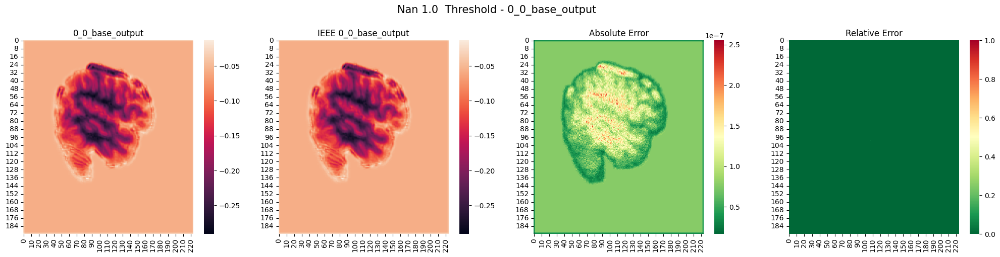

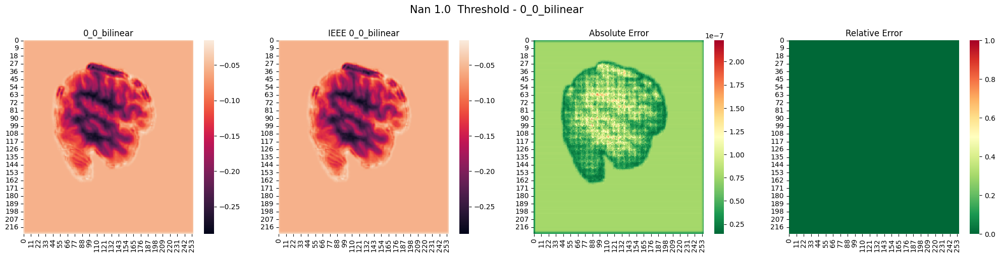

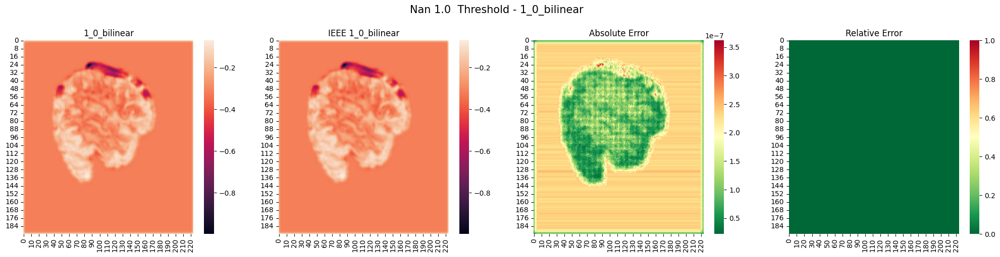

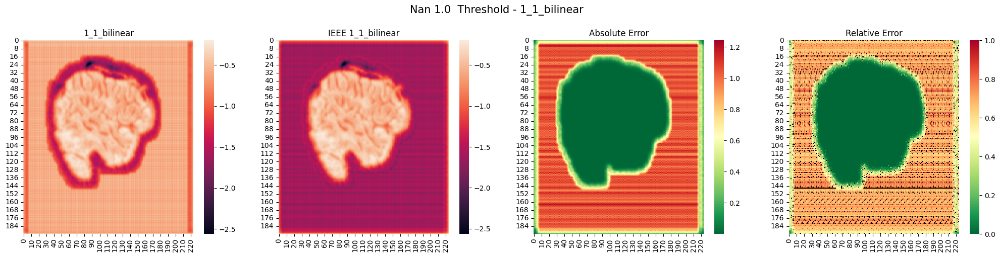

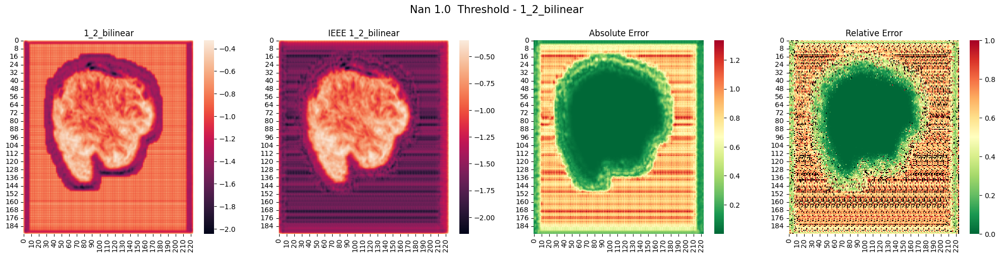

...

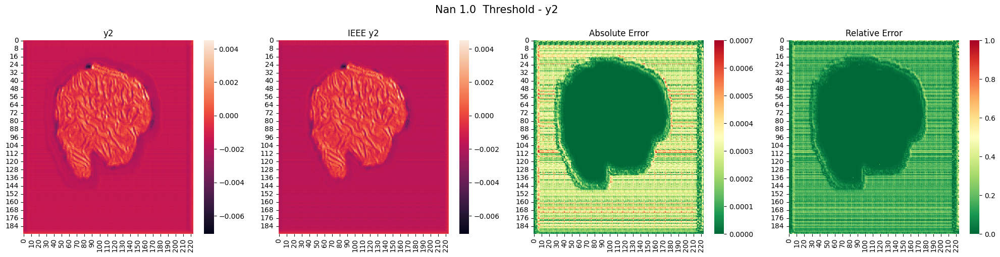

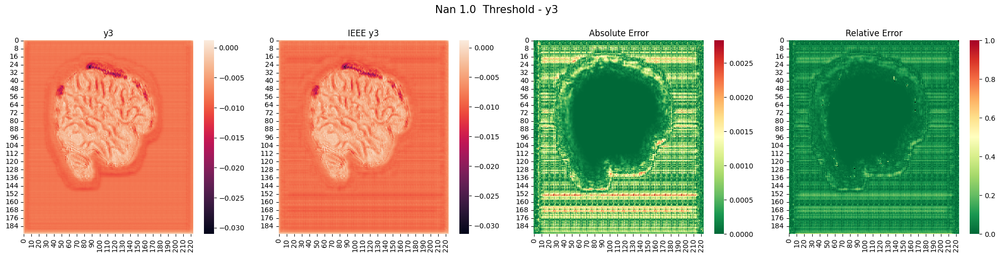

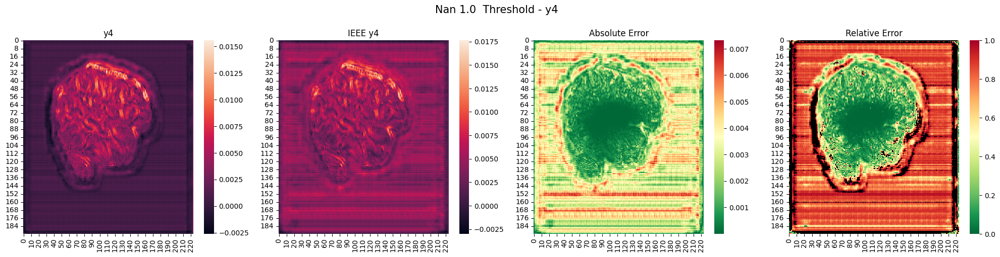

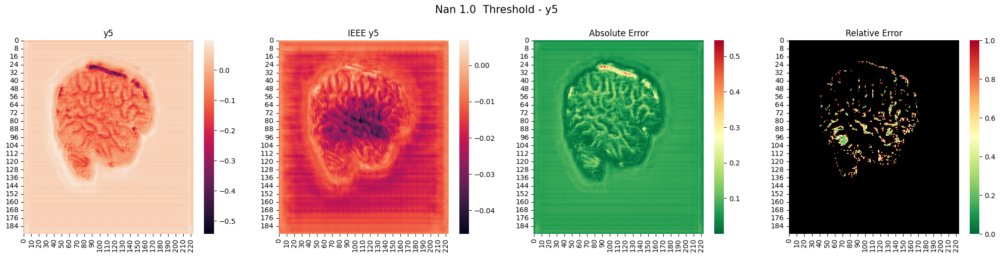

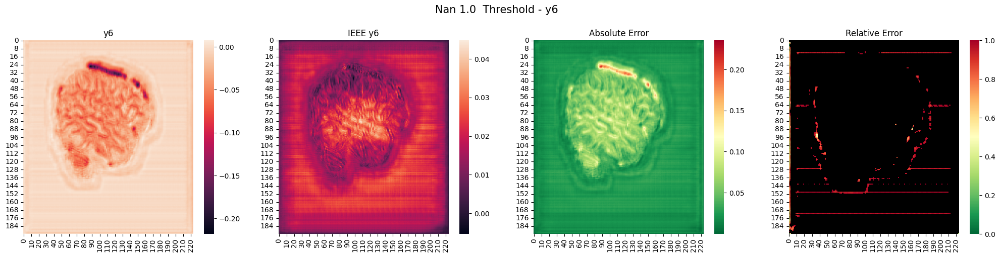

In [153]:
cmp_thresh_to_ieee('Nan 1.0 ',ieee_root='/workspaces/FONDUE/embeddings/ieee/ieee_axial', nan_root='/workspaces/FONDUE/embeddings/nan_1_0/nan_1_0_axial')


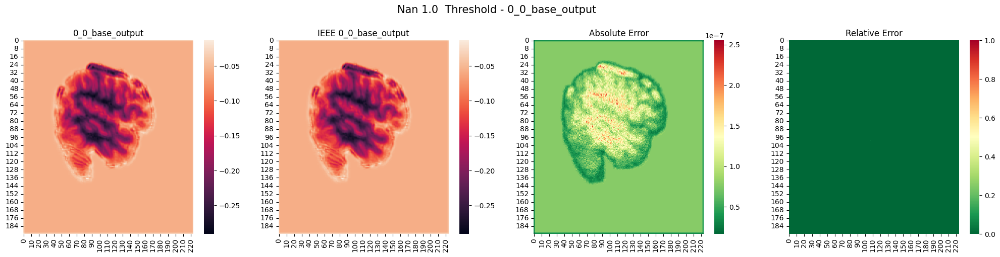

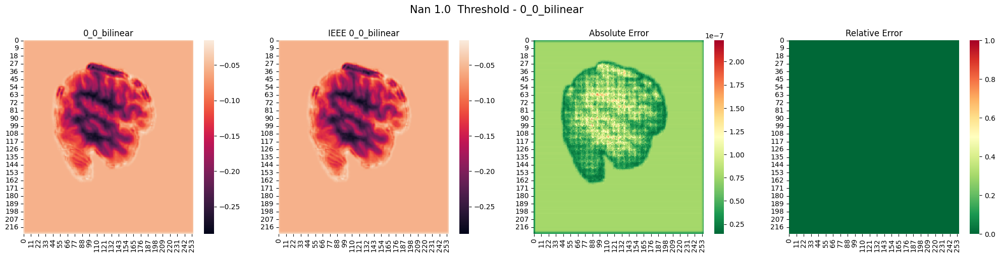

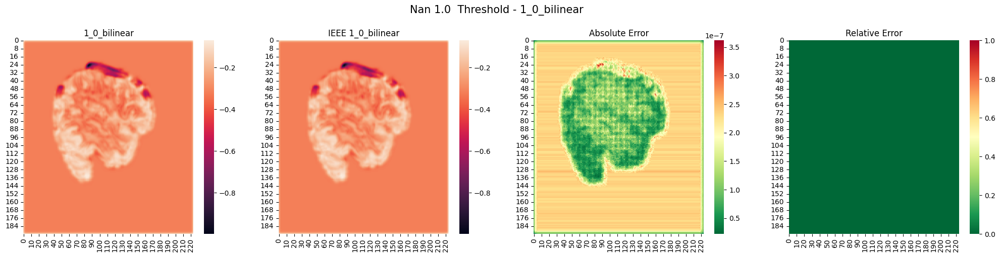

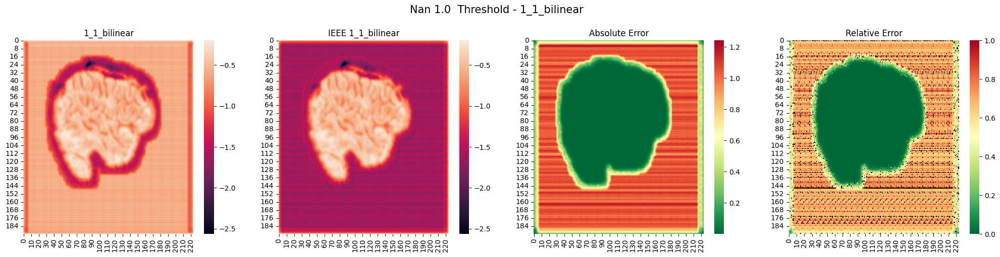

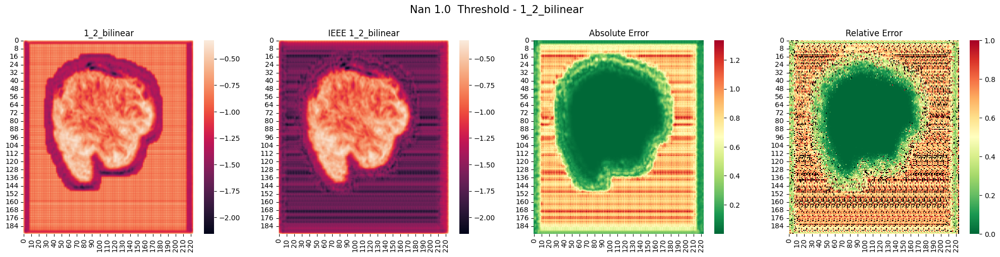

...

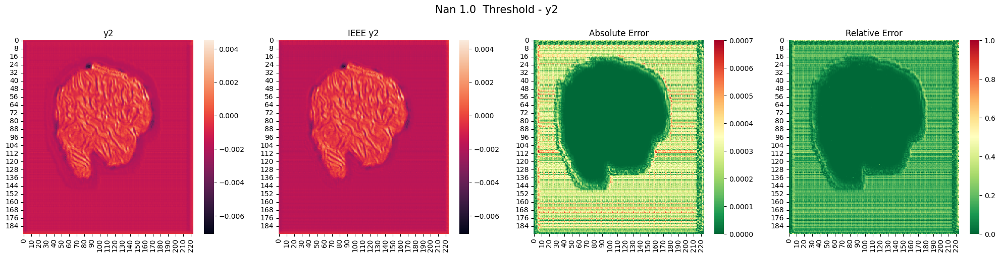

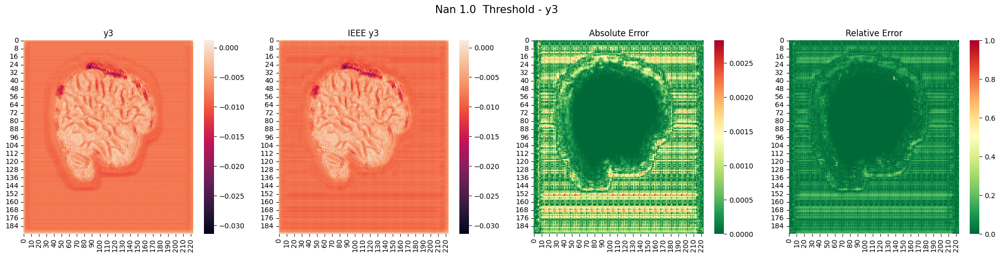

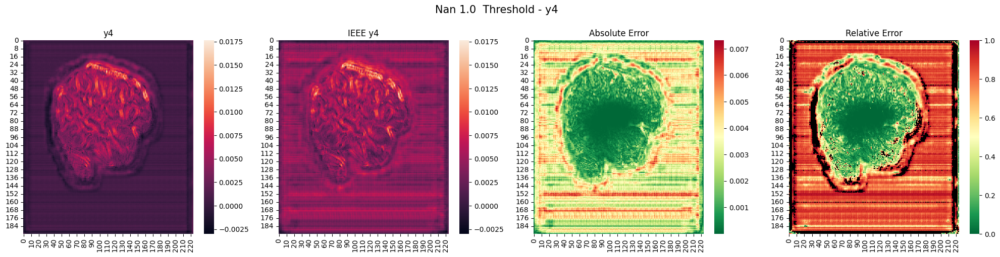

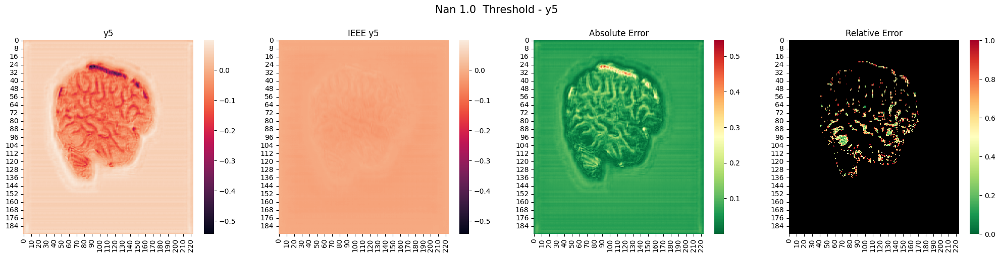

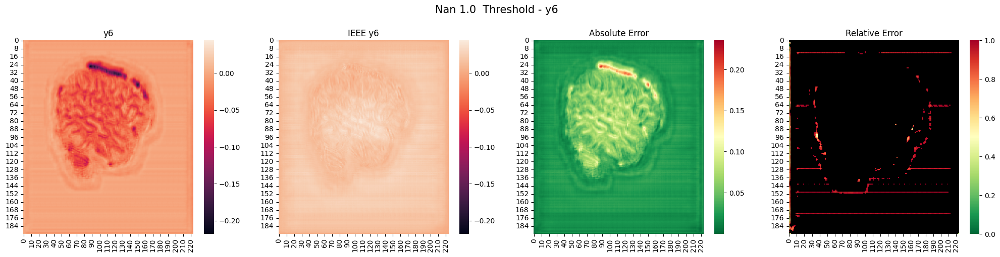

In [155]:
cmp_thresh_to_ieee('Nan 1.0 ',ieee_root='/workspaces/FONDUE/embeddings/ieee/ieee_axial', nan_root='/workspaces/FONDUE/embeddings/nan_1_0/nan_1_0_axial')